In [1]:
import numpy as np 
import pandas as pd
import json 
import csv
import nltk
import unicodedata
import re
import sys
from gensim.models.coherencemodel import CoherenceModel
from gensim import corpora, models
from gensim.utils import simple_preprocess
import gensim, spacy
from gensim.models.ldamulticore import LdaMulticore
import re
from gensim.models import Phrases
from gensim.models.phrases import Phraser

import os

In [2]:
# pip install git+https://github.com/rwalk/gsdmm.git

In [3]:
from gsdmm import MovieGroupProcess

In [4]:
df = pd.read_csv("pos_neg_usa.csv")
df

,Unnamed: 0,index,Text,new_text,languages,new_text_after_translation,pos_tagged_words,words_processed_all,words_processed_noun_adj_verb_adv,words_processed_noun,text_type,sentiment
0,0,0,want find way end racism try force people inje...,want find way end racism try force people inje...,ENGLISH,want find way end racism try force people inje...,"[('want', 'JJ'), ('find', 'VB'), ('way', 'NN')...","['want', 'find', 'way', 'end', 'racism', 'try'...","['want', 'find', 'way', 'end', 'racism', 'try'...","['way', 'end', 'racism', 'force', 'people', 'b...",subjective,2
1,1,1,"this child almost died tetanus, spent months h...","this child almost died tetanus, spent months h...",ENGLISH,"this child almost died tetanus, spent months h...","[('this', 'DT'), ('child', 'NN'), ('almost', '...","['child', 'almost', 'died', 'tetanus', 'spent'...","['child', 'almost', 'die', 'tetanus', 'spend',...","['child', 'tetanus', 'month', 'hospital', 'cos...",subjective,0
2,2,2,juste se rappeler m. leblanc la pression que l...,juste se rappeler m. leblanc la pression que l...,FRENCH,just remember mr. leblanc the pressure that th...,"[('just', 'RB'), ('remember', 'VB'), ('my', 'P...","['remember', 'leblanc', 'pressure', 'provincia...","['remember', 'leblanc', 'pressure', 'provincia...","['leblanc', 'pressure', 'business', 'world', '...",subjective,0
3,3,3,"you would expect cases rise significantly, cou...","you would expect cases rise significantly, cou...",ENGLISH,"you would expect cases rise significantly, cou...","[('you', 'PRP'), ('would', 'MD'), ('expect', '...","['would', 'expect', 'case', 'rise', 'significa...","['would', 'expect', 'case', 'rise', 'significa...","['case', 'vaccination', 'rate', 'play', 'space...",subjective,2
4,4,4,depends whether vaccination status is embedded...,depends whether vaccination status is embedded...,ENGLISH,depends whether vaccination status is embedded...,"[('depends', 'VBZ'), ('whether', 'IN'), ('vacc...","['depends', 'whether', 'vaccination', 'status'...","['depend', 'vaccination', 'status', 'embed', '...","['vaccination', 'status', 'code', 'link', 'con...",subjective,2
...,...,...,...,...,...,...,...,...,...,...,...,...
315598,404255,404255,pretty remarkable achievement. thank you all v...,pretty remarkable achievement. thank you all v...,ENGLISH,pretty remarkable achievement. thank you all v...,"[('pretty', 'RB'), ('remarkable', 'JJ'), ('ach...","['pretty', 'remarkable', 'achievement', 'thank...","['pretty', 'remarkable', 'achievement', 'thank...","['achievement', 'volunteer', 'shotsshotsshot',...",subjective,2
315599,404258,404258,oh that explains similar - seemingly out nowhe...,oh that explains similar - seemingly out nowhe...,ENGLISH,oh that explains similar - seemingly out nowhe...,"[('oh', 'UH'), ('that', 'DT'), ('explains', 'V...","['explains', 'similar', 'seemingly', 'nowhere'...","['explain', 'similar', 'seemingly', 'nowhere',...","['message', 'background', 'folk', 'vaccinesave...",subjective,0
315600,404260,404260,do it others.... 💪🎉💉🤙 #vaccinesaveslives,do it others.... flexed_bicepsparty_poppersyri...,ENGLISH,do it others.... flexed_bicepsparty_poppersyri...,"[('do', 'VB'), ('it', 'PRP'), ('others', 'NNS'...","['others', 'vaccinesaveslives']","['other', 'vaccinesaveslive']","['other', 'vaccinesaveslive']",subjective,2
315601,404262,404262,yay 🙌🏻 congrats dr. j being fully vaccinated i...,yay raising_handslight_skin_tone congrats dr. ...,ENGLISH,yay raising_handslight_skin_tone congrats dr. ...,"[('yay', 'NN'), ('congrats', 'NNS'), ('do', 'V...","['yay', 'congrats', 'fully', 'vaccinated', 'be...","['congrat', 'fully', 'vaccinate', 'good', 'fee...","['congrat', 'feeling', 'safetyfirst', 'vaccine...",subjective,2


In [5]:
df.drop(columns = ['Unnamed: 0', 'Text', 'index', 'new_text', 'languages','pos_tagged_words'], inplace = True)
df

,new_text_after_translation,words_processed_all,words_processed_noun_adj_verb_adv,words_processed_noun,text_type,sentiment
0,want find way end racism try force people inje...,"['want', 'find', 'way', 'end', 'racism', 'try'...","['want', 'find', 'way', 'end', 'racism', 'try'...","['way', 'end', 'racism', 'force', 'people', 'b...",subjective,2
1,"this child almost died tetanus, spent months h...","['child', 'almost', 'died', 'tetanus', 'spent'...","['child', 'almost', 'die', 'tetanus', 'spend',...","['child', 'tetanus', 'month', 'hospital', 'cos...",subjective,0
2,just remember mr. leblanc the pressure that th...,"['remember', 'leblanc', 'pressure', 'provincia...","['remember', 'leblanc', 'pressure', 'provincia...","['leblanc', 'pressure', 'business', 'world', '...",subjective,0
3,"you would expect cases rise significantly, cou...","['would', 'expect', 'case', 'rise', 'significa...","['would', 'expect', 'case', 'rise', 'significa...","['case', 'vaccination', 'rate', 'play', 'space...",subjective,2
4,depends whether vaccination status is embedded...,"['depends', 'whether', 'vaccination', 'status'...","['depend', 'vaccination', 'status', 'embed', '...","['vaccination', 'status', 'code', 'link', 'con...",subjective,2
...,...,...,...,...,...,...
315598,pretty remarkable achievement. thank you all v...,"['pretty', 'remarkable', 'achievement', 'thank...","['pretty', 'remarkable', 'achievement', 'thank...","['achievement', 'volunteer', 'shotsshotsshot',...",subjective,2
315599,oh that explains similar - seemingly out nowhe...,"['explains', 'similar', 'seemingly', 'nowhere'...","['explain', 'similar', 'seemingly', 'nowhere',...","['message', 'background', 'folk', 'vaccinesave...",subjective,0
315600,do it others.... flexed_bicepsparty_poppersyri...,"['others', 'vaccinesaveslives']","['other', 'vaccinesaveslive']","['other', 'vaccinesaveslive']",subjective,2
315601,yay raising_handslight_skin_tone congrats dr. ...,"['yay', 'congrats', 'fully', 'vaccinated', 'be...","['congrat', 'fully', 'vaccinate', 'good', 'fee...","['congrat', 'feeling', 'safetyfirst', 'vaccine...",subjective,2


In [6]:
df['words_processed_all'].values[0][0]

'['

In [7]:
def sent_to_words(sentences):
    for sentence in sentences:
        yield(gensim.utils.simple_preprocess(str(sentence), deacc=True))

In [8]:
tokens_words_processed_all = list(sent_to_words(df['words_processed_all']))

In [9]:
from nltk.corpus import stopwords
stop_list = stopwords.words('english')
high_freq_known_words = ['covid','couid', 'pfizer', 'amp', 'people', 'covidvaccine', 'covishield', 'moderna', 'vaccine', 'astrazeneca', 'vaccinate', 'vaccinated', 'vaccination', 'vaccines']

stop_list.extend(high_freq_known_words)

test_words_only1 = ['not', 'vaccine', 'covid', 'and', 'vegan', 'cruelty', 'free', 'i', 'use', 'elf', 'cosmetics', 'every', 'day', 'and', 'i', 'love', 'it']
test_stopremoved = [w for w in test_words_only1 if w not in stop_list or w == 'not']
print(test_stopremoved)

['not', 'vegan', 'cruelty', 'free', 'use', 'elf', 'cosmetics', 'every', 'day', 'love']


In [10]:
stop_list

['i',
 'me',
 'my',
 'myself',
 'we',
 'our',
 'ours',
 'ourselves',
 'you',
 "you're",
 "you've",
 "you'll",
 "you'd",
 'your',
 'yours',
 'yourself',
 'yourselves',
 'he',
 'him',
 'his',
 'himself',
 'she',
 "she's",
 'her',
 'hers',
 'herself',
 'it',
 "it's",
 'its',
 'itself',
 'they',
 'them',
 'their',
 'theirs',
 'themselves',
 'what',
 'which',
 'who',
 'whom',
 'this',
 'that',
 "that'll",
 'these',
 'those',
 'am',
 'is',
 'are',
 'was',
 'were',
 'be',
 'been',
 'being',
 'have',
 'has',
 'had',
 'having',
 'do',
 'does',
 'did',
 'doing',
 'a',
 'an',
 'the',
 'and',
 'but',
 'if',
 'or',
 'because',
 'as',
 'until',
 'while',
 'of',
 'at',
 'by',
 'for',
 'with',
 'about',
 'against',
 'between',
 'into',
 'through',
 'during',
 'before',
 'after',
 'above',
 'below',
 'to',
 'from',
 'up',
 'down',
 'in',
 'out',
 'on',
 'off',
 'over',
 'under',
 'again',
 'further',
 'then',
 'once',
 'here',
 'there',
 'when',
 'where',
 'why',
 'how',
 'all',
 'any',
 'both',
 'each

In [11]:
df['words_processed_all'] = tokens_words_processed_all

In [12]:
# remove stop words from tokenised_words_only

tokenised_stopremoved = [[w for w in each if w not in stop_list or w == 'not'] for each in tokens_words_processed_all]
tokenised_stopremoved

[['want',
  'find',
  'way',
  'end',
  'racism',
  'try',
  'force',
  'inject',
  'see',
  'bunch',
  'race',
  'standing',
  'forced',
  'not',
  'need',
  'support',
  'getting',
  'shot',
  'draw_line',
  'force'],
 ['child',
  'almost',
  'died',
  'tetanus',
  'spent',
  'month',
  'hospital',
  'cost',
  'around',
  'parent',
  'still',
  'refused',
  'pre',
  'pandemic'],
 ['remember',
  'leblanc',
  'pressure',
  'provincial',
  'business',
  'world',
  'asked',
  'able',
  'open',
  'border',
  'air',
  'traffic',
  'provincial',
  'govt',
  'ac',
  'included',
  'block',
  'tourist',
  'not',
  'pas',
  'hotel',
  'restaurant'],
 ['would',
  'expect',
  'case',
  'rise',
  'significantly',
  'course',
  'rate',
  'come',
  'play',
  'space',
  'adult',
  'not',
  'usually',
  'confined',
  'single',
  'space',
  'many',
  'school',
  'age',
  'student',
  'data',
  'state',
  'lifted',
  'not',
  'bear'],
 ['depends',
  'whether',
  'status',
  'embedded',
  'code',
  'code

In [13]:
df['words_processed_all'].values[0][0]

'want'

In [14]:
df['tokenised_stopremoved'] = tokenised_stopremoved

In [15]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 315603 entries, 0 to 315602
Data columns (total 7 columns):
 #   Column                             Non-Null Count   Dtype 
---  ------                             --------------   ----- 
 0   new_text_after_translation         315603 non-null  object
 1   words_processed_all                315603 non-null  object
 2   words_processed_noun_adj_verb_adv  315603 non-null  object
 3   words_processed_noun               315603 non-null  object
 4   text_type                          315603 non-null  object
 5   sentiment                          315603 non-null  int64 
 6   tokenised_stopremoved              315603 non-null  object
dtypes: int64(1), object(6)
memory usage: 16.9+ MB


# GSDMM for the topic modeling: 

In [16]:
np.random.seed(0)

In [17]:
df.info() # no empty rows

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 315603 entries, 0 to 315602
Data columns (total 7 columns):
 #   Column                             Non-Null Count   Dtype 
---  ------                             --------------   ----- 
 0   new_text_after_translation         315603 non-null  object
 1   words_processed_all                315603 non-null  object
 2   words_processed_noun_adj_verb_adv  315603 non-null  object
 3   words_processed_noun               315603 non-null  object
 4   text_type                          315603 non-null  object
 5   sentiment                          315603 non-null  int64 
 6   tokenised_stopremoved              315603 non-null  object
dtypes: int64(1), object(6)
memory usage: 16.9+ MB


In [18]:
df['sentiment'].value_counts()

2    222780
0     92823
Name: sentiment, dtype: int64

In [19]:
negative_df = df[df['sentiment'] == 0]

In [20]:
negative_df

,new_text_after_translation,words_processed_all,words_processed_noun_adj_verb_adv,words_processed_noun,text_type,sentiment,tokenised_stopremoved
1,"this child almost died tetanus, spent months h...","[child, almost, died, tetanus, spent, month, h...","['child', 'almost', 'die', 'tetanus', 'spend',...","['child', 'tetanus', 'month', 'hospital', 'cos...",subjective,0,"[child, almost, died, tetanus, spent, month, h..."
2,just remember mr. leblanc the pressure that th...,"[remember, leblanc, pressure, provincial, busi...","['remember', 'leblanc', 'pressure', 'provincia...","['leblanc', 'pressure', 'business', 'world', '...",subjective,0,"[remember, leblanc, pressure, provincial, busi..."
9,does it hurt your head actually use your brain...,"[hurt, head, actually, use, brain, seem, incre...","['head', 'actually', 'use', 'brain', 'seem', '...","['head', 'brain', 'place', 'vaccination', 'rat...",subjective,0,"[hurt, head, actually, use, brain, seem, incre..."
10,world-wide mass vaccination leading world-wide...,"[world, wide, mass, vaccination, leading, worl...","['wide', 'mass', 'vaccination', 'lead', 'world...","['vaccination', 'world', 'passport', 'goal', '...",subjective,0,"[world, wide, mass, leading, world, wide, digi..."
19,oh i see. so what your saying is that alberta ...,"[see, saying, alberta, business, required, ask...","['say', 'business', 'require', 'proof', 'vacci...","['business', 'proof', 'vaccination', 'governme...",subjective,0,"[see, saying, alberta, business, required, ask..."
...,...,...,...,...,...,...,...
315583,half my friends sick af. all vaccinated. sheesh,"[half, friend, sick, vaccinated, sheesh]","['half', 'friend', 'sick', 'vaccinate', 'sheesh']",['friend'],subjective,0,"[half, friend, sick, sheesh]"
315584,merry christmas Christmas_tree i hope things i...,"[merry_christmas, hope, thing, improve, son, a...","['hope', 'thing', 'improve', 'son', 'triple', ...","['thing', 'son', 'friend', 'amp', 'daughter', ...",subjective,0,"[merry_christmas, hope, thing, improve, son, g..."
315587,no me refería este positivo grinning_face_with...,"[refer, este, positive, positive, covidtesting]","['refer', 'positive', 'positive', 'covidtestin...","['covidtesting', 'vaccinesaveslive']",subjective,0,"[refer, este, positive, positive, covidtesting]"
315592,acute #stroke #covid pneumonia #novax #coronav...,"[acute, stroke, couid, pneumonia, nova, corona...","['acute', 'vaccinate', 'vaccinesaveslive', 'va...","['vaccinesaveslive', 'vaccine', 'deltavariant']",subjective,0,"[acute, stroke, pneumonia, nova, coronavirus, ..."


In [21]:
negative_df['tokenised_stopremoved'].values[0][0]

'child'

In [22]:
negative_tokenised_lemmatized = list(sent_to_words(negative_df['tokenised_stopremoved']))

In [23]:
negative_tokenised_lemmatized[0][0]

'child'

In [24]:
len(negative_tokenised_lemmatized)

92823

In [25]:
def top_words(cluster_word_distribution, top_cluster, values):
    for cluster in top_cluster:
        sort_dicts =sorted(mgp.cluster_word_distribution[cluster].items(), key=lambda k: k[1], reverse=True)[:values]
        print("\nCluster %s : %s"%(cluster,sort_dicts))

### Cluster size: 4

In [26]:
mgp = MovieGroupProcess(K=4, alpha=0.1, beta=0.2, n_iters=30)

vocab = set(x for review in negative_tokenised_lemmatized for x in review)
n_terms = len(vocab)
model = mgp.fit(negative_tokenised_lemmatized, n_terms)

In stage 0: transferred 64545 clusters with 4 clusters populated
In stage 1: transferred 51158 clusters with 4 clusters populated
In stage 2: transferred 35133 clusters with 4 clusters populated
In stage 3: transferred 23643 clusters with 4 clusters populated
In stage 4: transferred 19375 clusters with 4 clusters populated
In stage 5: transferred 17796 clusters with 4 clusters populated
In stage 6: transferred 17258 clusters with 4 clusters populated
In stage 7: transferred 16899 clusters with 4 clusters populated
In stage 8: transferred 16737 clusters with 4 clusters populated
In stage 9: transferred 16769 clusters with 4 clusters populated
In stage 10: transferred 16556 clusters with 4 clusters populated
In stage 11: transferred 16511 clusters with 4 clusters populated
In stage 12: transferred 16531 clusters with 4 clusters populated
In stage 13: transferred 16578 clusters with 4 clusters populated
In stage 14: transferred 16242 clusters with 4 clusters populated
In stage 15: transfe

In [27]:
doc_count = np.array(mgp.cluster_doc_count)
print('Number of documents per topic :', doc_count)

# topics sorted by the number of document they are allocated to
top_index = doc_count.argsort()[-10:][::-1]
print('\nMost important clusters (by number of docs inside):', top_index)
# show the top 5 words in term frequency for each cluster 
top_words(mgp.cluster_word_distribution, top_index, 10)

Number of documents per topic : [29283 18528 30696 14316]

Most important clusters (by number of docs inside): [2 0 1 3]

Cluster 2 : [('get', 10281), ('not', 8661), ('death', 4494), ('one', 4217), ('die', 3861), ('rate', 3182), ('shot', 3048), ('booster', 2925), ('still', 2887), ('hospital', 2733)]

Cluster 0 : [('anti', 10450), ('not', 8131), ('get', 7044), ('van', 3827), ('say', 3232), ('die', 2690), ('go', 2665), ('mask', 2524), ('like', 2459), ('one', 2374)]

Cluster 1 : [('not', 5420), ('get', 3587), ('mandate', 2277), ('one', 1666), ('mask', 1508), ('want', 1338), ('go', 1331), ('would', 1254), ('trucker', 1205), ('like', 1203)]

Cluster 3 : [('not', 3648), ('modern', 3316), ('one', 1657), ('get', 1607), ('say', 1102), ('make', 1009), ('know', 984), ('take', 943), ('government', 925), ('trump', 921)]


In [28]:
# I don`t rename the clusters

topic_dict = {}
topic_names = ['type 1',
               'type 2',
               'type 3',
               'type 4'
              ]
for i, topic_num in enumerate(top_index):
    topic_dict[topic_num]=topic_names[i] 

In [29]:
def create_topics_dataframe(data_text=negative_df.new_text_after_translation,  mgp=mgp, threshold=0.3, topic_dict=topic_dict, lemma_text=negative_tokenised_lemmatized):
    result = pd.DataFrame(columns=['Text', 'Topic', 'Lemma-text'])
    for i, text in enumerate(data_text):
        result.at[i, 'Text'] = text
        result.at[i, 'Lemma-text'] = lemma_text[i]
        prob = mgp.choose_best_label(negative_tokenised_lemmatized[i])
        if prob[1] >= threshold:
            result.at[i, 'Topic'] = topic_dict[prob[0]]
        else:
            result.at[i, 'Topic'] = 'Other'
    return result

In [30]:
result = create_topics_dataframe(data_text=negative_df.new_text_after_translation, mgp=mgp, threshold=0.3, topic_dict=topic_dict, lemma_text=negative_tokenised_lemmatized)
result.head(5)

,Text,Topic,Lemma-text
0,"this child almost died tetanus, spent months h...",type 1,"[child, almost, died, tetanus, spent, month, h..."
1,just remember mr. leblanc the pressure that th...,type 3,"[remember, leblanc, pressure, provincial, busi..."
2,does it hurt your head actually use your brain...,type 3,"[hurt, head, actually, use, brain, seem, incre..."
3,world-wide mass vaccination leading world-wide...,type 3,"[world, wide, mass, leading, world, wide, digi..."
4,oh i see. so what your saying is that alberta ...,type 3,"[see, saying, alberta, business, required, ask..."


In [31]:
import plotly.express as px

fig = px.pie(result, names='Topic',  title='Topics', color_discrete_sequence=px.colors.sequential.Burg)
fig.show()

In [32]:
result['Topic']

0        type 1
1        type 3
2        type 3
3        type 3
4        type 3
          ...  
92818    type 1
92819    type 1
92820    type 1
92821    type 1
92822    type 1
Name: Topic, Length: 92823, dtype: object

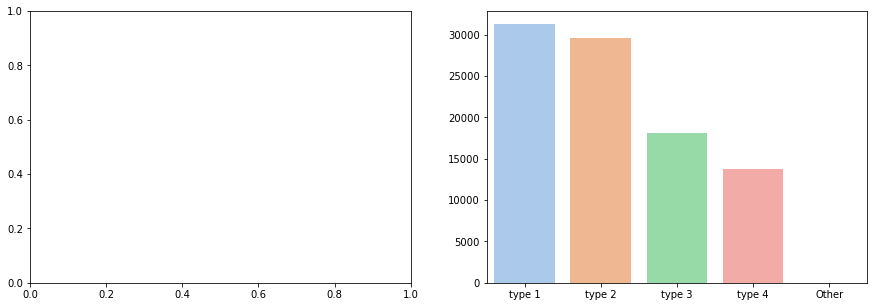

In [33]:
import matplotlib.pyplot as plt
import seaborn as sns
types_counts = result.Topic.value_counts()
fig, ax = plt.subplots(1, 2, figsize=(15,5))
types = sns.barplot(x = types_counts.index, y = types_counts.values, palette="pastel", ax=ax[1])


In [34]:
result['len'] = result.Text.apply(lambda row: len(row.split()))
result.head()

,Text,Topic,Lemma-text,len
0,"this child almost died tetanus, spent months h...",type 1,"[child, almost, died, tetanus, spent, month, h...",21
1,just remember mr. leblanc the pressure that th...,type 3,"[remember, leblanc, pressure, provincial, busi...",48
2,does it hurt your head actually use your brain...,type 3,"[hurt, head, actually, use, brain, seem, incre...",37
3,world-wide mass vaccination leading world-wide...,type 3,"[world, wide, mass, leading, world, wide, digi...",11
4,oh i see. so what your saying is that alberta ...,type 3,"[see, saying, alberta, business, required, ask...",26


In [35]:
result['Lemma_text'] = result['Lemma-text'].apply(lambda row: ' '.join(row))

In [36]:
result = result.drop('Lemma-text', axis=1)

In [37]:
from wordcloud import WordCloud 

In [38]:
def create_WordCloud(data, title=None):
    wordcloud = WordCloud(width = 500, height = 500,
                          background_color ='white',
                          min_font_size = 15, collocations=False
                         ).generate(" ".join(data.values))
                      
    plt.figure(figsize = (5, 5), facecolor = None) 
    plt.imshow(wordcloud, interpolation='bilinear') 
    plt.axis("off") 
    plt.tight_layout(pad = 0) 
    plt.title(title,fontsize=20)
    plt.show() 

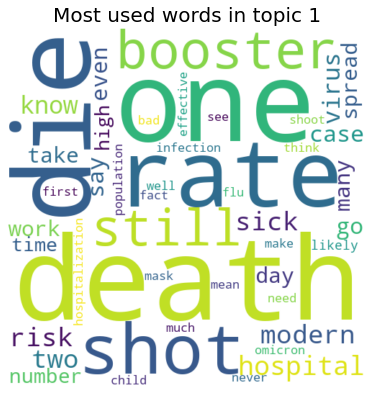

In [39]:
create_WordCloud(result['Lemma_text'].loc[result.Topic == 'type 1'], title="Most used words in topic 1")

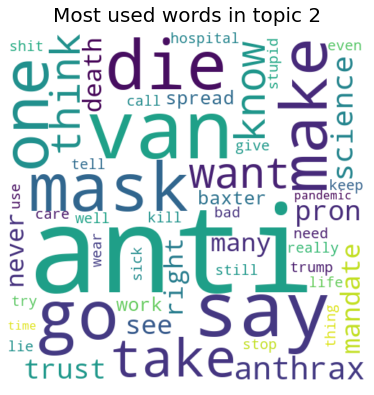

In [40]:
create_WordCloud(result['Lemma_text'].loc[result.Topic == 'type 2'], title="Most used words in topic 2")

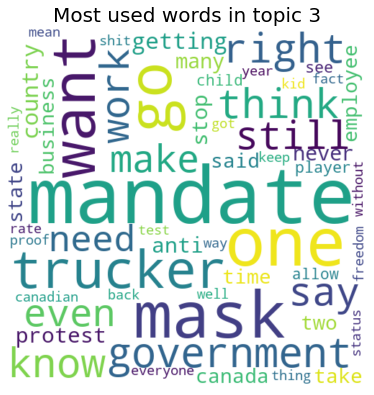

In [41]:
create_WordCloud(result['Lemma_text'].loc[result.Topic == 'type 3'], title="Most used words in topic 3")

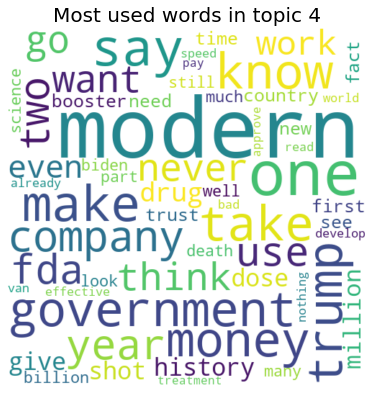

In [42]:
create_WordCloud(result['Lemma_text'].loc[result.Topic == 'type 4'], title="Most used words in topic 4")

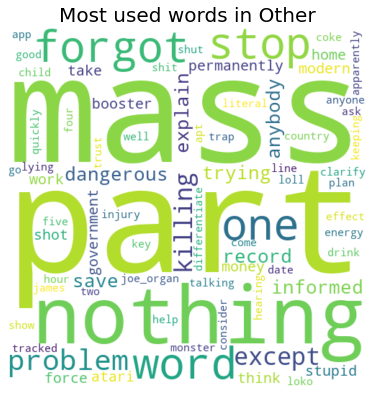

In [43]:
create_WordCloud(result['Lemma_text'].loc[result.Topic == 'Other'], title="Most used words in Other")

### Cluster size: 5

In [44]:
mgp = MovieGroupProcess(K=5, alpha=0.1, beta=0.2, n_iters=30)

vocab = set(x for review in negative_tokenised_lemmatized for x in review)
n_terms = len(vocab)
model = mgp.fit(negative_tokenised_lemmatized, n_terms)

In stage 0: transferred 69569 clusters with 5 clusters populated
In stage 1: transferred 55094 clusters with 5 clusters populated
In stage 2: transferred 35307 clusters with 5 clusters populated
In stage 3: transferred 23793 clusters with 5 clusters populated
In stage 4: transferred 19941 clusters with 5 clusters populated
In stage 5: transferred 18516 clusters with 5 clusters populated
In stage 6: transferred 17655 clusters with 5 clusters populated
In stage 7: transferred 17484 clusters with 5 clusters populated
In stage 8: transferred 17209 clusters with 5 clusters populated
In stage 9: transferred 17132 clusters with 5 clusters populated
In stage 10: transferred 16996 clusters with 5 clusters populated
In stage 11: transferred 16814 clusters with 5 clusters populated
In stage 12: transferred 16958 clusters with 5 clusters populated
In stage 13: transferred 16965 clusters with 5 clusters populated
In stage 14: transferred 16867 clusters with 5 clusters populated
In stage 15: transfe

In [45]:
doc_count = np.array(mgp.cluster_doc_count)
print('Number of documents per topic :', doc_count)

# topics sorted by the number of document they are allocated to
top_index = doc_count.argsort()[-10:][::-1]
print('\nMost important clusters (by number of docs inside):', top_index)
# show the top 5 words in term frequency for each cluster 
top_words(mgp.cluster_word_distribution, top_index, 10)

Number of documents per topic : [30201 14134 11417 15591 21480]

Most important clusters (by number of docs inside): [0 4 3 1 2]

Cluster 0 : [('anti', 9814), ('not', 8746), ('get', 8253), ('van', 3681), ('say', 3368), ('die', 3157), ('go', 3000), ('mask', 2853), ('one', 2535), ('like', 2516)]

Cluster 4 : [('not', 6820), ('get', 5151), ('death', 4485), ('rate', 3386), ('die', 2927), ('one', 2903), ('risk', 2450), ('still', 2221), ('virus', 2091), ('hospital', 1880)]

Cluster 3 : [('not', 4652), ('get', 2706), ('mandate', 2377), ('anti', 1471), ('one', 1324), ('trucker', 1232), ('mask', 1211), ('government', 1161), ('want', 1159), ('like', 1032)]

Cluster 1 : [('not', 3676), ('modern', 2992), ('one', 1631), ('get', 1586), ('say', 1084), ('know', 1011), ('make', 1007), ('would', 948), ('take', 935), ('trump', 931)]

Cluster 2 : [('get', 4823), ('modern', 2699), ('shot', 2457), ('booster', 2261), ('not', 1966), ('one', 1521), ('two', 1435), ('day', 1256), ('shoot', 1182), ('sick', 1063)]

In [46]:
# I don`t rename the clusters

topic_dict = {}
topic_names = ['type 1',
               'type 2',
               'type 3',
               'type 4',
               'type 5'
              ]
for i, topic_num in enumerate(top_index):
    topic_dict[topic_num]=topic_names[i] 

In [47]:
def create_topics_dataframe(data_text=negative_df.new_text_after_translation,  mgp=mgp, threshold=0.3, topic_dict=topic_dict, lemma_text=negative_tokenised_lemmatized):
    result = pd.DataFrame(columns=['Text', 'Topic', 'Lemma-text'])
    for i, text in enumerate(data_text):
        result.at[i, 'Text'] = text
        result.at[i, 'Lemma-text'] = lemma_text[i]
        prob = mgp.choose_best_label(negative_tokenised_lemmatized[i])
        if prob[1] >= threshold:
            result.at[i, 'Topic'] = topic_dict[prob[0]]
        else:
            result.at[i, 'Topic'] = 'Other'
    return result

In [48]:
result = create_topics_dataframe(data_text=negative_df.new_text_after_translation, mgp=mgp, threshold=0.3, topic_dict=topic_dict, lemma_text=negative_tokenised_lemmatized)
result.head(5)

,Text,Topic,Lemma-text
0,"this child almost died tetanus, spent months h...",type 2,"[child, almost, died, tetanus, spent, month, h..."
1,just remember mr. leblanc the pressure that th...,type 3,"[remember, leblanc, pressure, provincial, busi..."
2,does it hurt your head actually use your brain...,type 3,"[hurt, head, actually, use, brain, seem, incre..."
3,world-wide mass vaccination leading world-wide...,type 3,"[world, wide, mass, leading, world, wide, digi..."
4,oh i see. so what your saying is that alberta ...,type 3,"[see, saying, alberta, business, required, ask..."


In [49]:
import plotly.express as px

fig = px.pie(result, names='Topic',  title='Topics', color_discrete_sequence=px.colors.sequential.Burg)
fig.show()

In [50]:
result['Topic']

0        type 2
1        type 3
2        type 3
3        type 3
4        type 3
          ...  
92818    type 5
92819    type 5
92820    type 5
92821    type 2
92822    type 4
Name: Topic, Length: 92823, dtype: object

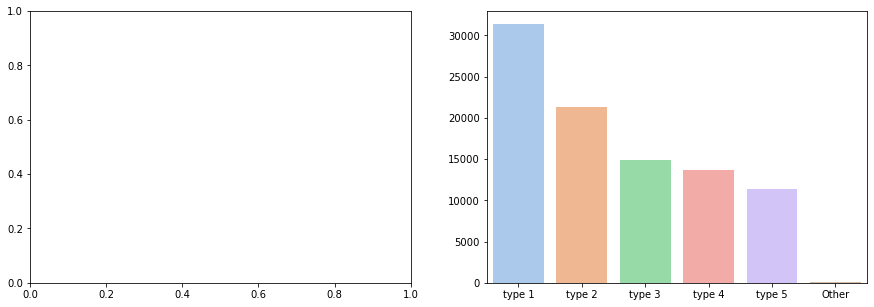

In [51]:
import matplotlib.pyplot as plt
import seaborn as sns
types_counts = result.Topic.value_counts()
fig, ax = plt.subplots(1, 2, figsize=(15,5))
types = sns.barplot(x = types_counts.index, y = types_counts.values, palette="pastel", ax=ax[1])


In [52]:
result['len'] = result.Text.apply(lambda row: len(row.split()))
result.head()

,Text,Topic,Lemma-text,len
0,"this child almost died tetanus, spent months h...",type 2,"[child, almost, died, tetanus, spent, month, h...",21
1,just remember mr. leblanc the pressure that th...,type 3,"[remember, leblanc, pressure, provincial, busi...",48
2,does it hurt your head actually use your brain...,type 3,"[hurt, head, actually, use, brain, seem, incre...",37
3,world-wide mass vaccination leading world-wide...,type 3,"[world, wide, mass, leading, world, wide, digi...",11
4,oh i see. so what your saying is that alberta ...,type 3,"[see, saying, alberta, business, required, ask...",26


In [53]:
result['Lemma_text'] = result['Lemma-text'].apply(lambda row: ' '.join(row))

In [54]:
result = result.drop('Lemma-text', axis=1)

In [55]:
from wordcloud import WordCloud 

In [56]:
def create_WordCloud(data, title=None):
    wordcloud = WordCloud(width = 500, height = 500,
                          background_color ='white',
                          min_font_size = 15, collocations=False
                         ).generate(" ".join(data.values))
                      
    plt.figure(figsize = (5, 5), facecolor = None) 
    plt.imshow(wordcloud, interpolation='bilinear') 
    plt.axis("off") 
    plt.tight_layout(pad = 0) 
    plt.title(title,fontsize=20)
    plt.show() 

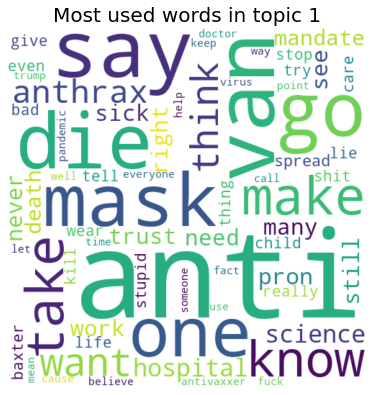

In [57]:
create_WordCloud(result['Lemma_text'].loc[result.Topic == 'type 1'], title="Most used words in topic 1")

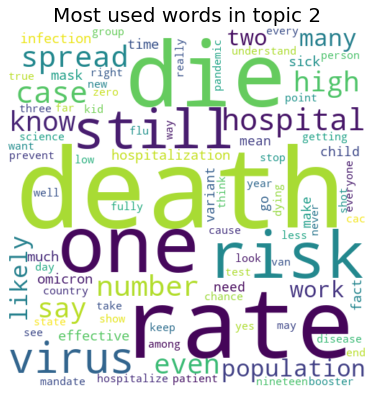

In [58]:
create_WordCloud(result['Lemma_text'].loc[result.Topic == 'type 2'], title="Most used words in topic 2")

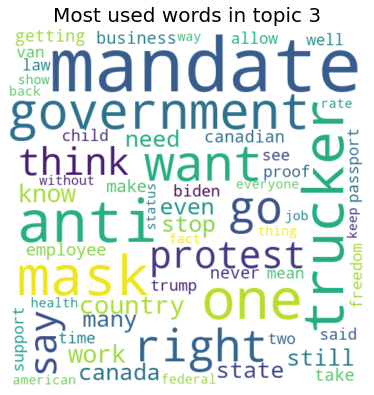

In [59]:
create_WordCloud(result['Lemma_text'].loc[result.Topic == 'type 3'], title="Most used words in topic 3")

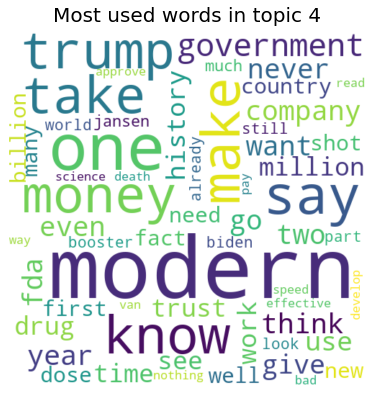

In [60]:
create_WordCloud(result['Lemma_text'].loc[result.Topic == 'type 4'], title="Most used words in topic 4")

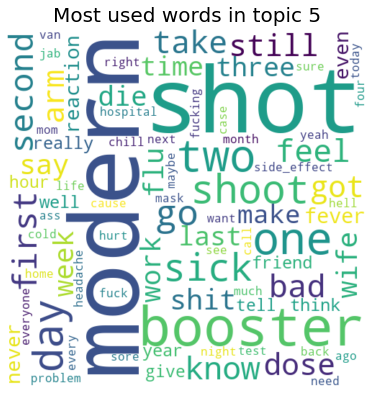

In [61]:
create_WordCloud(result['Lemma_text'].loc[result.Topic == 'type 5'], title="Most used words in topic 5")

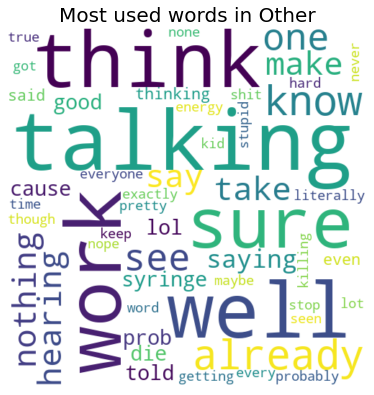

In [62]:
create_WordCloud(result['Lemma_text'].loc[result.Topic == 'Other'], title="Most used words in Other")

### Cluster size: 6

In [63]:
mgp = MovieGroupProcess(K=6, alpha=0.1, beta=0.2, n_iters=30)

vocab = set(x for review in negative_tokenised_lemmatized for x in review)
n_terms = len(vocab)
model = mgp.fit(negative_tokenised_lemmatized, n_terms)

In stage 0: transferred 72378 clusters with 6 clusters populated
In stage 1: transferred 58100 clusters with 6 clusters populated
In stage 2: transferred 40925 clusters with 6 clusters populated
In stage 3: transferred 28356 clusters with 6 clusters populated
In stage 4: transferred 22989 clusters with 6 clusters populated
In stage 5: transferred 21173 clusters with 6 clusters populated
In stage 6: transferred 20016 clusters with 6 clusters populated
In stage 7: transferred 19551 clusters with 6 clusters populated
In stage 8: transferred 19020 clusters with 6 clusters populated
In stage 9: transferred 18903 clusters with 6 clusters populated
In stage 10: transferred 18584 clusters with 6 clusters populated
In stage 11: transferred 18515 clusters with 6 clusters populated
In stage 12: transferred 18584 clusters with 6 clusters populated
In stage 13: transferred 18531 clusters with 6 clusters populated
In stage 14: transferred 18464 clusters with 6 clusters populated
In stage 15: transfe

In [64]:
doc_count = np.array(mgp.cluster_doc_count)
print('Number of documents per topic :', doc_count)

# topics sorted by the number of document they are allocated to
top_index = doc_count.argsort()[-10:][::-1]
print('\nMost important clusters (by number of docs inside):', top_index)
# show the top 5 words in term frequency for each cluster 
top_words(mgp.cluster_word_distribution, top_index, 10)

Number of documents per topic : [10418 20027 12624 23427  8728 17599]

Most important clusters (by number of docs inside): [3 1 5 2 0 4]

Cluster 3 : [('anti', 9740), ('not', 6412), ('get', 5315), ('van', 3602), ('say', 2758), ('die', 2303), ('like', 2013), ('go', 1921), ('anthrax', 1899), ('make', 1882)]

Cluster 1 : [('not', 6215), ('get', 4721), ('death', 4434), ('rate', 3291), ('die', 3144), ('one', 2710), ('risk', 2281), ('hospital', 2220), ('still', 1958), ('virus', 1928)]

Cluster 5 : [('get', 5838), ('not', 5746), ('mask', 2441), ('go', 1858), ('one', 1805), ('want', 1474), ('still', 1433), ('know', 1404), ('sick', 1316), ('would', 1292)]

Cluster 2 : [('not', 3326), ('modern', 2871), ('one', 1472), ('get', 1423), ('say', 990), ('make', 925), ('know', 908), ('government', 894), ('money', 870), ('take', 865)]

Cluster 0 : [('not', 2802), ('mandate', 1848), ('get', 1366), ('anti', 1322), ('trucker', 1201), ('government', 964), ('one', 825), ('protest', 813), ('country', 740), ('r

In [65]:
# I don`t rename the clusters

topic_dict = {}
topic_names = ['type 1',
               'type 2',
               'type 3',
               'type 4',
               'type 5',
               'type 6'
              ]
for i, topic_num in enumerate(top_index):
    topic_dict[topic_num]=topic_names[i] 

In [66]:
def create_topics_dataframe(data_text=negative_df.new_text_after_translation,  mgp=mgp, threshold=0.3, topic_dict=topic_dict, lemma_text=negative_tokenised_lemmatized):
    result = pd.DataFrame(columns=['Text', 'Topic', 'Lemma-text'])
    for i, text in enumerate(data_text):
        result.at[i, 'Text'] = text
        result.at[i, 'Lemma-text'] = lemma_text[i]
        prob = mgp.choose_best_label(negative_tokenised_lemmatized[i])
        if prob[1] >= threshold:
            result.at[i, 'Topic'] = topic_dict[prob[0]]
        else:
            result.at[i, 'Topic'] = 'Other'
    return result

In [67]:
result = create_topics_dataframe(data_text=negative_df.new_text_after_translation, mgp=mgp, threshold=0.3, topic_dict=topic_dict, lemma_text=negative_tokenised_lemmatized)
result.head(5)

,Text,Topic,Lemma-text
0,"this child almost died tetanus, spent months h...",type 3,"[child, almost, died, tetanus, spent, month, h..."
1,just remember mr. leblanc the pressure that th...,type 5,"[remember, leblanc, pressure, provincial, busi..."
2,does it hurt your head actually use your brain...,type 5,"[hurt, head, actually, use, brain, seem, incre..."
3,world-wide mass vaccination leading world-wide...,type 5,"[world, wide, mass, leading, world, wide, digi..."
4,oh i see. so what your saying is that alberta ...,type 5,"[see, saying, alberta, business, required, ask..."


In [68]:
import plotly.express as px

fig = px.pie(result, names='Topic',  title='Topics', color_discrete_sequence=px.colors.sequential.Burg)
fig.show()

In [69]:
result['Topic']

0        type 3
1        type 5
2        type 5
3        type 5
4        type 5
          ...  
92818    type 6
92819    type 6
92820    type 3
92821    type 2
92822    type 2
Name: Topic, Length: 92823, dtype: object

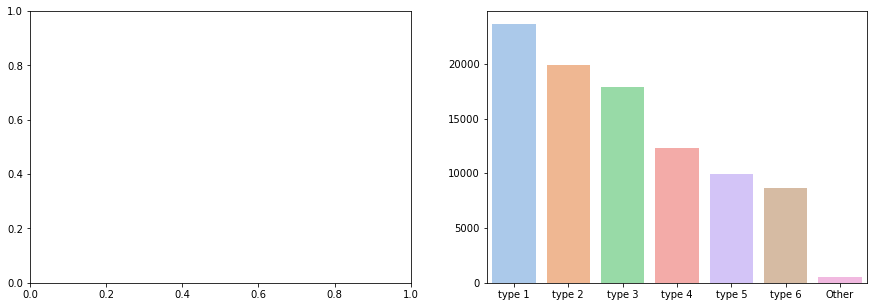

In [70]:
import matplotlib.pyplot as plt
import seaborn as sns
types_counts = result.Topic.value_counts()
fig, ax = plt.subplots(1, 2, figsize=(15,5))
types = sns.barplot(x = types_counts.index, y = types_counts.values, palette="pastel", ax=ax[1])


In [71]:
result['len'] = result.Text.apply(lambda row: len(row.split()))
result.head()

,Text,Topic,Lemma-text,len
0,"this child almost died tetanus, spent months h...",type 3,"[child, almost, died, tetanus, spent, month, h...",21
1,just remember mr. leblanc the pressure that th...,type 5,"[remember, leblanc, pressure, provincial, busi...",48
2,does it hurt your head actually use your brain...,type 5,"[hurt, head, actually, use, brain, seem, incre...",37
3,world-wide mass vaccination leading world-wide...,type 5,"[world, wide, mass, leading, world, wide, digi...",11
4,oh i see. so what your saying is that alberta ...,type 5,"[see, saying, alberta, business, required, ask...",26


In [72]:
result['Lemma_text'] = result['Lemma-text'].apply(lambda row: ' '.join(row))

In [73]:
result = result.drop('Lemma-text', axis=1)

In [74]:
from wordcloud import WordCloud 

In [75]:
def create_WordCloud(data, title=None):
    wordcloud = WordCloud(width = 500, height = 500,
                          background_color ='white',
                          min_font_size = 15, collocations=False
                         ).generate(" ".join(data.values))
                      
    plt.figure(figsize = (5, 5), facecolor = None) 
    plt.imshow(wordcloud, interpolation='bilinear') 
    plt.axis("off") 
    plt.tight_layout(pad = 0) 
    plt.title(title,fontsize=20)
    plt.show() 

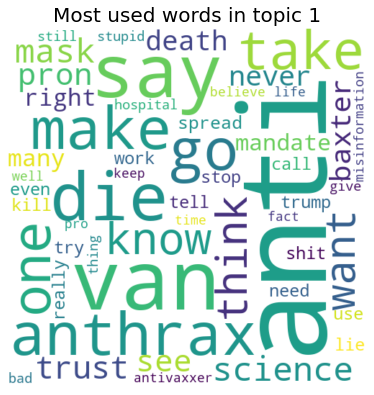

In [76]:
create_WordCloud(result['Lemma_text'].loc[result.Topic == 'type 1'], title="Most used words in topic 1")

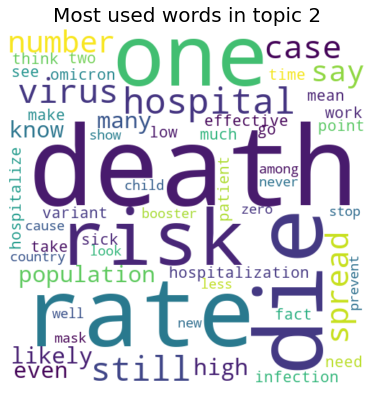

In [77]:
create_WordCloud(result['Lemma_text'].loc[result.Topic == 'type 2'], title="Most used words in topic 2")

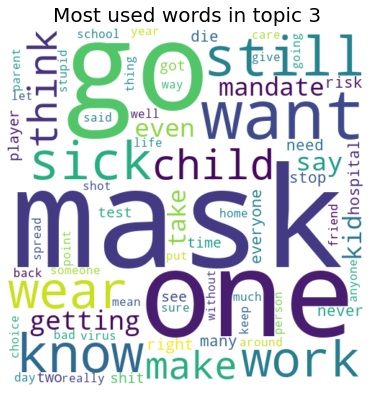

In [78]:
create_WordCloud(result['Lemma_text'].loc[result.Topic == 'type 3'], title="Most used words in topic 3")

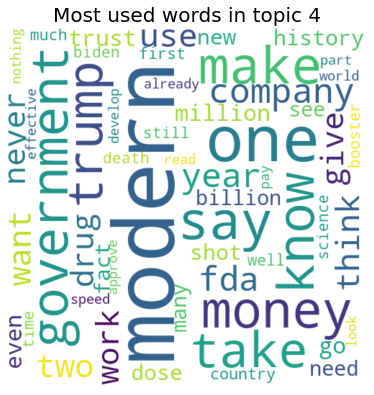

In [79]:
create_WordCloud(result['Lemma_text'].loc[result.Topic == 'type 4'], title="Most used words in topic 4")

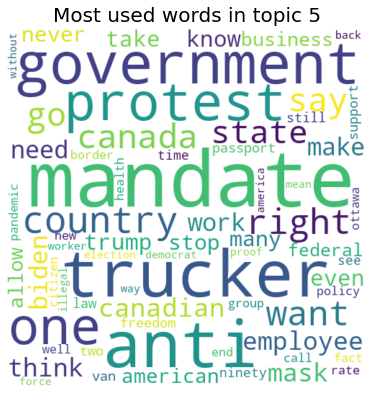

In [80]:
create_WordCloud(result['Lemma_text'].loc[result.Topic == 'type 5'], title="Most used words in topic 5")

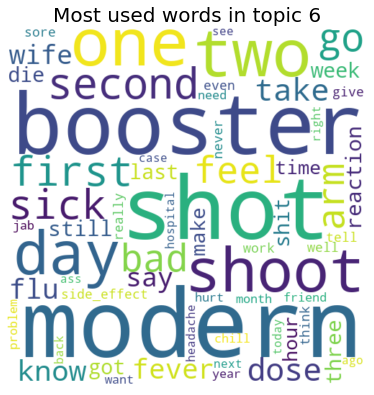

In [81]:
create_WordCloud(result['Lemma_text'].loc[result.Topic == 'type 6'], title="Most used words in topic 6")

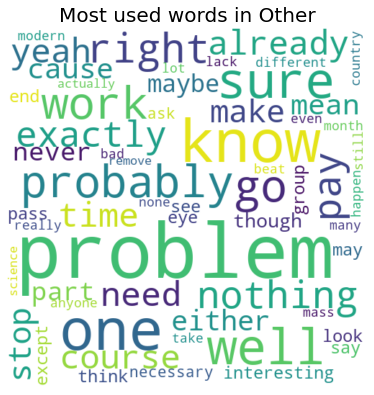

In [82]:
create_WordCloud(result['Lemma_text'].loc[result.Topic == 'Other'], title="Most used words in Other")

### Cluster size: 7

In [83]:
mgp = MovieGroupProcess(K=7, alpha=0.1, beta=0.2, n_iters=30)

vocab = set(x for review in negative_tokenised_lemmatized for x in review)
n_terms = len(vocab)
model = mgp.fit(negative_tokenised_lemmatized, n_terms)

In stage 0: transferred 74733 clusters with 7 clusters populated
In stage 1: transferred 58707 clusters with 7 clusters populated
In stage 2: transferred 41260 clusters with 7 clusters populated
In stage 3: transferred 30267 clusters with 7 clusters populated
In stage 4: transferred 24814 clusters with 7 clusters populated
In stage 5: transferred 22843 clusters with 7 clusters populated
In stage 6: transferred 21741 clusters with 7 clusters populated
In stage 7: transferred 21453 clusters with 7 clusters populated
In stage 8: transferred 21107 clusters with 7 clusters populated
In stage 9: transferred 21131 clusters with 7 clusters populated
In stage 10: transferred 20807 clusters with 7 clusters populated
In stage 11: transferred 20645 clusters with 7 clusters populated
In stage 12: transferred 20623 clusters with 7 clusters populated
In stage 13: transferred 20721 clusters with 7 clusters populated
In stage 14: transferred 20565 clusters with 7 clusters populated
In stage 15: transfe

In [84]:
doc_count = np.array(mgp.cluster_doc_count)
print('Number of documents per topic :', doc_count)

# topics sorted by the number of document they are allocated to
top_index = doc_count.argsort()[-10:][::-1]
print('\nMost important clusters (by number of docs inside):', top_index)
# show the top 5 words in term frequency for each cluster 
top_words(mgp.cluster_word_distribution, top_index, 10)

Number of documents per topic : [12885  1862 12493 18737 10519 13384 22943]

Most important clusters (by number of docs inside): [6 3 5 0 2 4 1]

Cluster 6 : [('get', 8945), ('not', 8372), ('die', 3730), ('hospital', 2967), ('mask', 2601), ('still', 2331), ('one', 2274), ('go', 2270), ('sick', 2261), ('virus', 2235)]

Cluster 3 : [('anti', 9213), ('not', 4707), ('van', 3395), ('get', 3133), ('say', 2196), ('anthrax', 1775), ('like', 1624), ('one', 1469), ('make', 1444), ('know', 1433)]

Cluster 5 : [('get', 5351), ('modern', 2771), ('shot', 2550), ('booster', 2337), ('not', 2314), ('one', 1703), ('two', 1475), ('day', 1302), ('shoot', 1224), ('go', 1221)]

Cluster 0 : [('not', 3863), ('mandate', 2199), ('get', 2171), ('trucker', 1199), ('one', 1070), ('government', 1062), ('want', 1033), ('anti', 965), ('mask', 943), ('go', 874)]

Cluster 2 : [('not', 3598), ('modern', 2318), ('get', 1621), ('one', 1474), ('say', 1037), ('know', 991), ('make', 979), ('trump', 971), ('take', 933), ('mon

In [85]:
# I don`t rename the clusters

topic_dict = {}
topic_names = ['type 1',
               'type 2',
               'type 3',
               'type 4',
               'type 5',
               'type 6',
               'type 7'
              ]
for i, topic_num in enumerate(top_index):
    topic_dict[topic_num]=topic_names[i] 

In [86]:
def create_topics_dataframe(data_text=negative_df.new_text_after_translation,  mgp=mgp, threshold=0.3, topic_dict=topic_dict, lemma_text=negative_tokenised_lemmatized):
    result = pd.DataFrame(columns=['Text', 'Topic', 'Lemma-text'])
    for i, text in enumerate(data_text):
        result.at[i, 'Text'] = text
        result.at[i, 'Lemma-text'] = lemma_text[i]
        prob = mgp.choose_best_label(negative_tokenised_lemmatized[i])
        if prob[1] >= threshold:
            result.at[i, 'Topic'] = topic_dict[prob[0]]
        else:
            result.at[i, 'Topic'] = 'Other'
    return result

In [87]:
result = create_topics_dataframe(data_text=negative_df.new_text_after_translation, mgp=mgp, threshold=0.3, topic_dict=topic_dict, lemma_text=negative_tokenised_lemmatized)
result.head(5)

,Text,Topic,Lemma-text
0,"this child almost died tetanus, spent months h...",type 1,"[child, almost, died, tetanus, spent, month, h..."
1,just remember mr. leblanc the pressure that th...,type 4,"[remember, leblanc, pressure, provincial, busi..."
2,does it hurt your head actually use your brain...,type 4,"[hurt, head, actually, use, brain, seem, incre..."
3,world-wide mass vaccination leading world-wide...,type 4,"[world, wide, mass, leading, world, wide, digi..."
4,oh i see. so what your saying is that alberta ...,type 4,"[see, saying, alberta, business, required, ask..."


In [88]:
import plotly.express as px

fig = px.pie(result, names='Topic',  title='Topics', color_discrete_sequence=px.colors.sequential.Burg)
fig.show()

In [89]:
result['Topic']

0        type 1
1        type 4
2        type 4
3        type 4
4        type 4
          ...  
92818    type 3
92819    type 3
92820    type 3
92821    type 6
92822    type 6
Name: Topic, Length: 92823, dtype: object

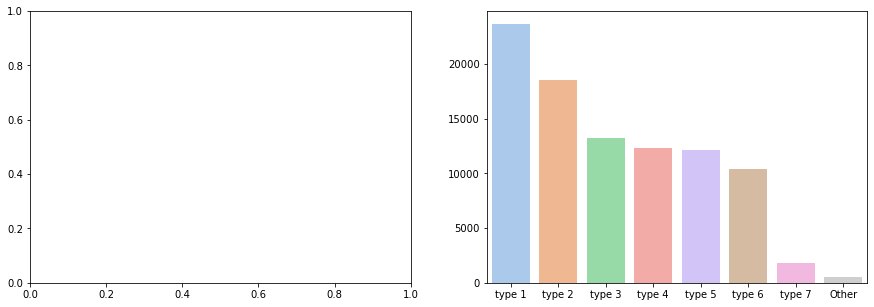

In [90]:
import matplotlib.pyplot as plt
import seaborn as sns
types_counts = result.Topic.value_counts()
fig, ax = plt.subplots(1, 2, figsize=(15,5))
types = sns.barplot(x = types_counts.index, y = types_counts.values, palette="pastel", ax=ax[1])


In [91]:
result['len'] = result.Text.apply(lambda row: len(row.split()))
result.head()

,Text,Topic,Lemma-text,len
0,"this child almost died tetanus, spent months h...",type 1,"[child, almost, died, tetanus, spent, month, h...",21
1,just remember mr. leblanc the pressure that th...,type 4,"[remember, leblanc, pressure, provincial, busi...",48
2,does it hurt your head actually use your brain...,type 4,"[hurt, head, actually, use, brain, seem, incre...",37
3,world-wide mass vaccination leading world-wide...,type 4,"[world, wide, mass, leading, world, wide, digi...",11
4,oh i see. so what your saying is that alberta ...,type 4,"[see, saying, alberta, business, required, ask...",26


In [92]:
result['Lemma_text'] = result['Lemma-text'].apply(lambda row: ' '.join(row))

In [93]:
result = result.drop('Lemma-text', axis=1)

In [94]:
from wordcloud import WordCloud 

In [95]:
def create_WordCloud(data, title=None):
    wordcloud = WordCloud(width = 500, height = 500,
                          background_color ='white',
                          min_font_size = 15, collocations=False
                         ).generate(" ".join(data.values))
                      
    plt.figure(figsize = (5, 5), facecolor = None) 
    plt.imshow(wordcloud, interpolation='bilinear') 
    plt.axis("off") 
    plt.tight_layout(pad = 0) 
    plt.title(title,fontsize=20)
    plt.show() 

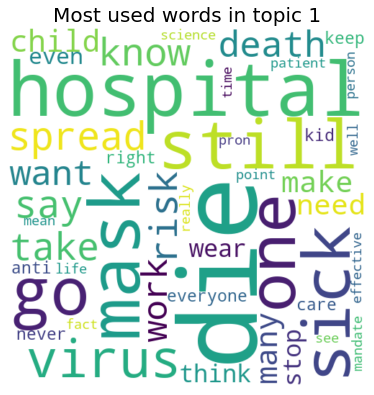

In [96]:
create_WordCloud(result['Lemma_text'].loc[result.Topic == 'type 1'], title="Most used words in topic 1")

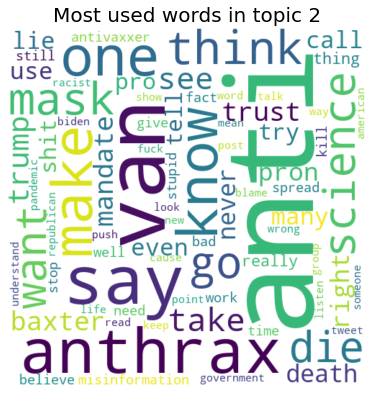

In [97]:
create_WordCloud(result['Lemma_text'].loc[result.Topic == 'type 2'], title="Most used words in topic 2")

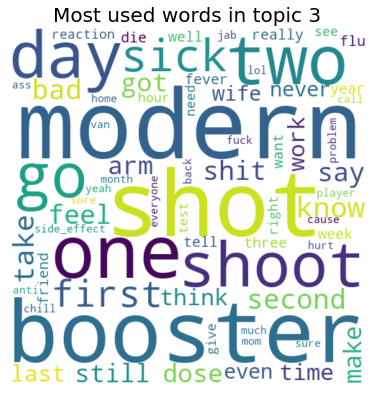

In [98]:
create_WordCloud(result['Lemma_text'].loc[result.Topic == 'type 3'], title="Most used words in topic 3")

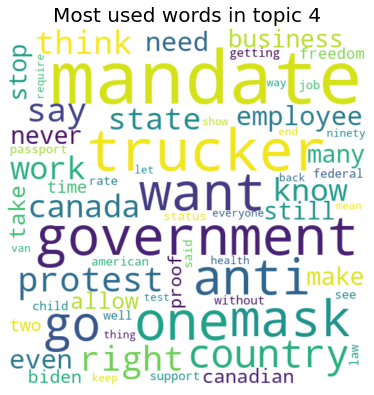

In [99]:
create_WordCloud(result['Lemma_text'].loc[result.Topic == 'type 4'], title="Most used words in topic 4")

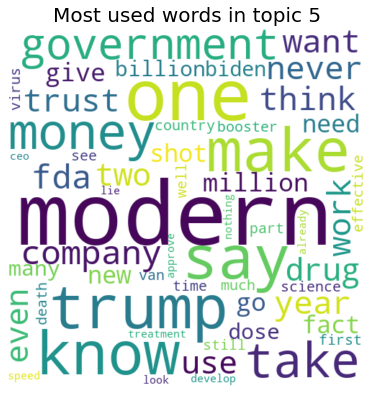

In [100]:
create_WordCloud(result['Lemma_text'].loc[result.Topic == 'type 5'], title="Most used words in topic 5")

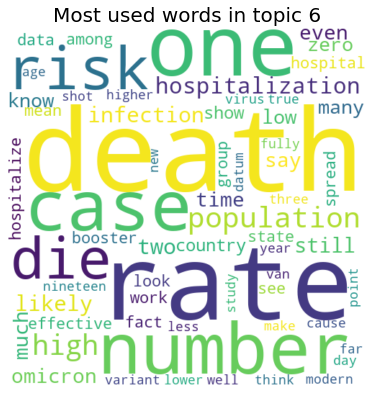

In [101]:
create_WordCloud(result['Lemma_text'].loc[result.Topic == 'type 6'], title="Most used words in topic 6")

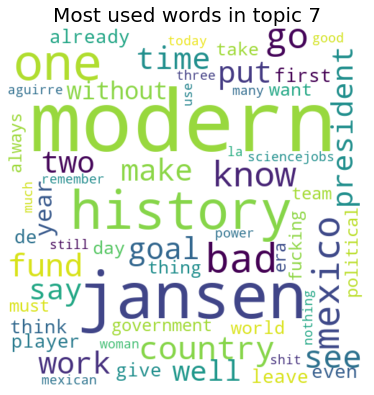

In [102]:
create_WordCloud(result['Lemma_text'].loc[result.Topic == 'type 7'], title="Most used words in topic 7")

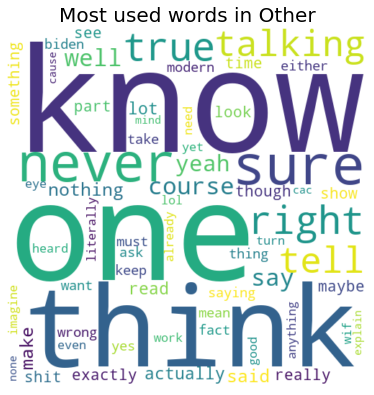

In [103]:
create_WordCloud(result['Lemma_text'].loc[result.Topic == 'Other'], title="Most used words in Other")

### Cluster size: 8

In [104]:
mgp = MovieGroupProcess(K=8, alpha=0.1, beta=0.2, n_iters=30)

vocab = set(x for review in negative_tokenised_lemmatized for x in review)
n_terms = len(vocab)
model = mgp.fit(negative_tokenised_lemmatized, n_terms)

In stage 0: transferred 76213 clusters with 8 clusters populated
In stage 1: transferred 61412 clusters with 8 clusters populated
In stage 2: transferred 45929 clusters with 8 clusters populated
In stage 3: transferred 33022 clusters with 8 clusters populated
In stage 4: transferred 27725 clusters with 8 clusters populated
In stage 5: transferred 24895 clusters with 8 clusters populated
In stage 6: transferred 23633 clusters with 8 clusters populated
In stage 7: transferred 22874 clusters with 8 clusters populated
In stage 8: transferred 22249 clusters with 8 clusters populated
In stage 9: transferred 21923 clusters with 8 clusters populated
In stage 10: transferred 21356 clusters with 8 clusters populated
In stage 11: transferred 21246 clusters with 8 clusters populated
In stage 12: transferred 21131 clusters with 8 clusters populated
In stage 13: transferred 20905 clusters with 8 clusters populated
In stage 14: transferred 20894 clusters with 8 clusters populated
In stage 15: transfe

In [105]:
doc_count = np.array(mgp.cluster_doc_count)
print('Number of documents per topic :', doc_count)

# topics sorted by the number of document they are allocated to
top_index = doc_count.argsort()[-10:][::-1]
print('\nMost important clusters (by number of docs inside):', top_index)
# show the top 5 words in term frequency for each cluster 
top_words(mgp.cluster_word_distribution, top_index, 10)

Number of documents per topic : [ 2372 16821 13468 10519 18311 10503 12364  8465]

Most important clusters (by number of docs inside): [4 1 2 6 3 5 7 0]

Cluster 4 : [('get', 6971), ('not', 6148), ('die', 3059), ('hospital', 2604), ('go', 2332), ('mask', 2257), ('sick', 1734), ('one', 1715), ('take', 1675), ('say', 1628)]

Cluster 1 : [('anti', 8770), ('not', 4169), ('van', 3282), ('get', 2593), ('say', 1976), ('anthrax', 1681), ('like', 1541), ('one', 1337), ('make', 1312), ('know', 1284)]

Cluster 2 : [('not', 3911), ('death', 3660), ('rate', 2986), ('get', 2319), ('one', 2000), ('die', 1786), ('risk', 1703), ('case', 1439), ('number', 1347), ('population', 1253)]

Cluster 6 : [('not', 4229), ('get', 3160), ('one', 1305), ('getting', 1177), ('mask', 1138), ('know', 1109), ('would', 974), ('like', 962), ('still', 876), ('mandate', 827)]

Cluster 3 : [('get', 4427), ('shot', 2093), ('booster', 1941), ('not', 1917), ('modern', 1780), ('one', 1342), ('two', 1081), ('go', 1055), ('know', 

In [106]:
# I don`t rename the clusters

topic_dict = {}
topic_names = ['type 1',
               'type 2',
               'type 3',
               'type 4',
               'type 5',
               'type 6',
               'type 7',
               'type 8'
              ]
for i, topic_num in enumerate(top_index):
    topic_dict[topic_num]=topic_names[i] 

In [107]:
def create_topics_dataframe(data_text=negative_df.new_text_after_translation,  mgp=mgp, threshold=0.3, topic_dict=topic_dict, lemma_text=negative_tokenised_lemmatized):
    result = pd.DataFrame(columns=['Text', 'Topic', 'Lemma-text'])
    for i, text in enumerate(data_text):
        result.at[i, 'Text'] = text
        result.at[i, 'Lemma-text'] = lemma_text[i]
        prob = mgp.choose_best_label(negative_tokenised_lemmatized[i])
        if prob[1] >= threshold:
            result.at[i, 'Topic'] = topic_dict[prob[0]]
        else:
            result.at[i, 'Topic'] = 'Other'
    return result

In [108]:
result = create_topics_dataframe(data_text=negative_df.new_text_after_translation, mgp=mgp, threshold=0.3, topic_dict=topic_dict, lemma_text=negative_tokenised_lemmatized)
result.head(5)

,Text,Topic,Lemma-text
0,"this child almost died tetanus, spent months h...",type 4,"[child, almost, died, tetanus, spent, month, h..."
1,just remember mr. leblanc the pressure that th...,type 7,"[remember, leblanc, pressure, provincial, busi..."
2,does it hurt your head actually use your brain...,type 4,"[hurt, head, actually, use, brain, seem, incre..."
3,world-wide mass vaccination leading world-wide...,type 7,"[world, wide, mass, leading, world, wide, digi..."
4,oh i see. so what your saying is that alberta ...,type 7,"[see, saying, alberta, business, required, ask..."


In [109]:
import plotly.express as px

fig = px.pie(result, names='Topic',  title='Topics', color_discrete_sequence=px.colors.sequential.Burg)
fig.show()

In [110]:
result['Topic']

0        type 4
1        type 7
2        type 4
3        type 7
4        type 7
          ...  
92818    type 5
92819    type 5
92820    type 5
92821    type 3
92822    type 4
Name: Topic, Length: 92823, dtype: object

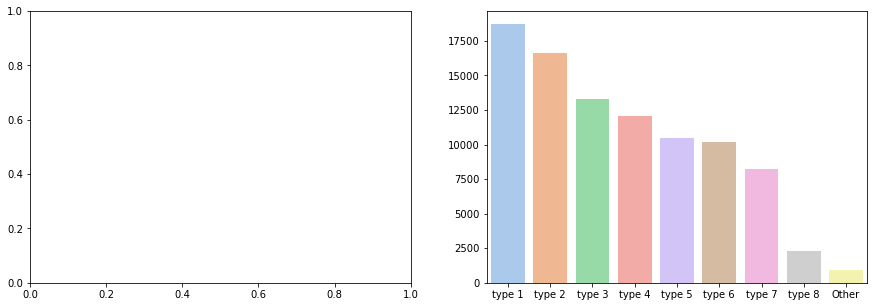

In [111]:
import matplotlib.pyplot as plt
import seaborn as sns
types_counts = result.Topic.value_counts()
fig, ax = plt.subplots(1, 2, figsize=(15,5))
types = sns.barplot(x = types_counts.index, y = types_counts.values, palette="pastel", ax=ax[1])


In [112]:
result['len'] = result.Text.apply(lambda row: len(row.split()))
result.head()

,Text,Topic,Lemma-text,len
0,"this child almost died tetanus, spent months h...",type 4,"[child, almost, died, tetanus, spent, month, h...",21
1,just remember mr. leblanc the pressure that th...,type 7,"[remember, leblanc, pressure, provincial, busi...",48
2,does it hurt your head actually use your brain...,type 4,"[hurt, head, actually, use, brain, seem, incre...",37
3,world-wide mass vaccination leading world-wide...,type 7,"[world, wide, mass, leading, world, wide, digi...",11
4,oh i see. so what your saying is that alberta ...,type 7,"[see, saying, alberta, business, required, ask...",26


In [113]:
result['Lemma_text'] = result['Lemma-text'].apply(lambda row: ' '.join(row))

In [114]:
result = result.drop('Lemma-text', axis=1)

In [115]:
from wordcloud import WordCloud 

In [116]:
def create_WordCloud(data, title=None):
    wordcloud = WordCloud(width = 500, height = 500,
                          background_color ='white',
                          min_font_size = 15, collocations=False
                         ).generate(" ".join(data.values))
                      
    plt.figure(figsize = (5, 5), facecolor = None) 
    plt.imshow(wordcloud, interpolation='bilinear') 
    plt.axis("off") 
    plt.tight_layout(pad = 0) 
    plt.title(title,fontsize=20)
    plt.show() 

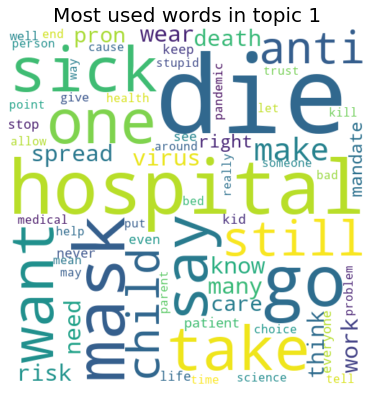

In [117]:
create_WordCloud(result['Lemma_text'].loc[result.Topic == 'type 1'], title="Most used words in topic 1")

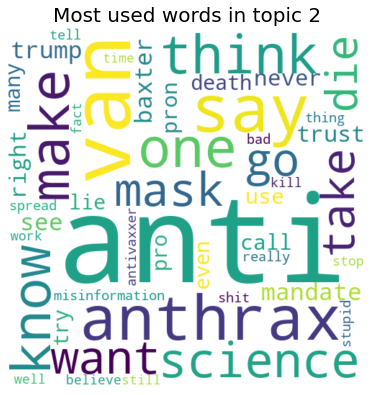

In [118]:
create_WordCloud(result['Lemma_text'].loc[result.Topic == 'type 2'], title="Most used words in topic 2")

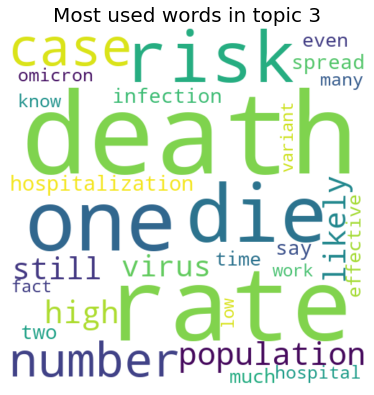

In [119]:
create_WordCloud(result['Lemma_text'].loc[result.Topic == 'type 3'], title="Most used words in topic 3")

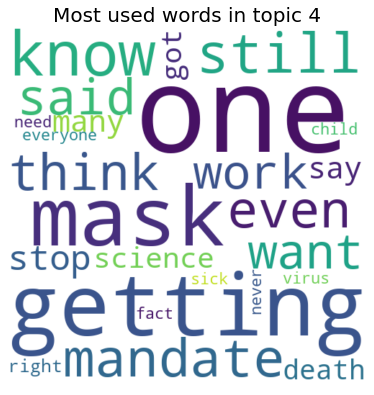

In [120]:
create_WordCloud(result['Lemma_text'].loc[result.Topic == 'type 4'], title="Most used words in topic 4")

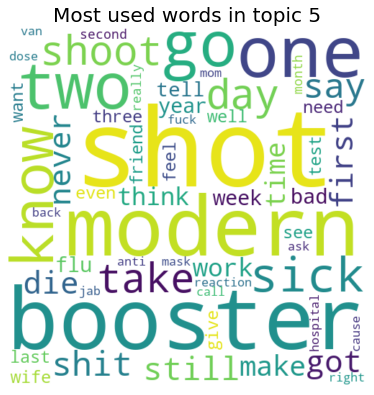

In [121]:
create_WordCloud(result['Lemma_text'].loc[result.Topic == 'type 5'], title="Most used words in topic 5")

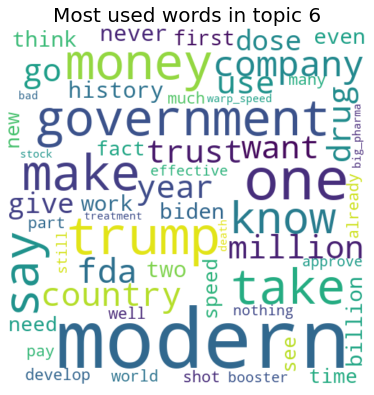

In [122]:
create_WordCloud(result['Lemma_text'].loc[result.Topic == 'type 6'], title="Most used words in topic 6")

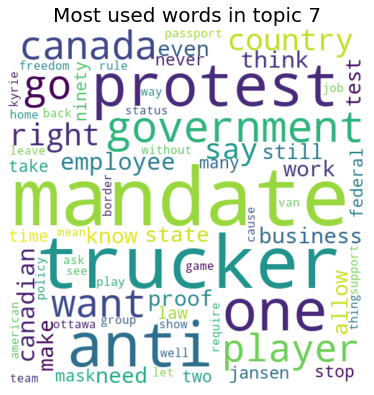

In [123]:
create_WordCloud(result['Lemma_text'].loc[result.Topic == 'type 7'], title="Most used words in topic 7")

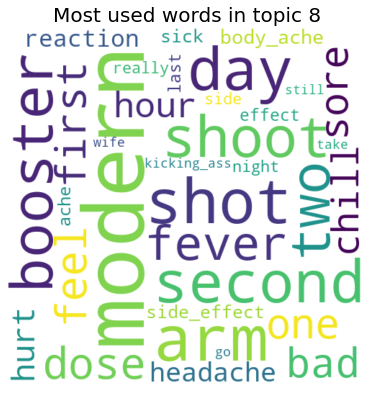

In [124]:
create_WordCloud(result['Lemma_text'].loc[result.Topic == 'type 8'], title="Most used words in topic 8")

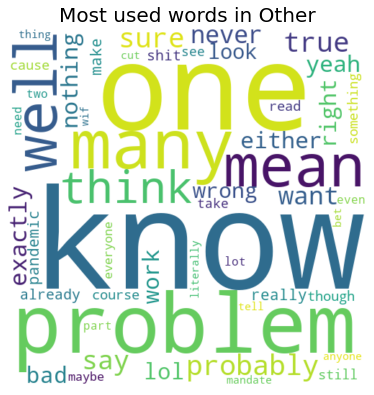

In [125]:
create_WordCloud(result['Lemma_text'].loc[result.Topic == 'Other'], title="Most used words in Other")

### Cluster size: 9

In [126]:
mgp = MovieGroupProcess(K=9, alpha=0.1, beta=0.2, n_iters=30)

vocab = set(x for review in negative_tokenised_lemmatized for x in review)
n_terms = len(vocab)
model = mgp.fit(negative_tokenised_lemmatized, n_terms)

In stage 0: transferred 77735 clusters with 9 clusters populated
In stage 1: transferred 62846 clusters with 9 clusters populated
In stage 2: transferred 45580 clusters with 9 clusters populated
In stage 3: transferred 32257 clusters with 9 clusters populated
In stage 4: transferred 26546 clusters with 9 clusters populated
In stage 5: transferred 23650 clusters with 9 clusters populated
In stage 6: transferred 22165 clusters with 9 clusters populated
In stage 7: transferred 21333 clusters with 9 clusters populated
In stage 8: transferred 20956 clusters with 9 clusters populated
In stage 9: transferred 20663 clusters with 9 clusters populated
In stage 10: transferred 20468 clusters with 9 clusters populated
In stage 11: transferred 20337 clusters with 9 clusters populated
In stage 12: transferred 20242 clusters with 9 clusters populated
In stage 13: transferred 20014 clusters with 9 clusters populated
In stage 14: transferred 19905 clusters with 9 clusters populated
In stage 15: transfe

In [127]:
doc_count = np.array(mgp.cluster_doc_count)
print('Number of documents per topic :', doc_count)

# topics sorted by the number of document they are allocated to
top_index = doc_count.argsort()[-10:][::-1]
print('\nMost important clusters (by number of docs inside):', top_index)
# show the top 5 words in term frequency for each cluster 
top_words(mgp.cluster_word_distribution, top_index, 10)

Number of documents per topic : [17082  8148 22103  8144  7438  1197  4488 14236  9987]

Most important clusters (by number of docs inside): [2 0 7 8 1 3 4 6 5]

Cluster 2 : [('get', 9182), ('not', 7558), ('die', 3198), ('mask', 2857), ('go', 2743), ('hospital', 2680), ('one', 2246), ('sick', 2228), ('still', 1934), ('want', 1927)]

Cluster 0 : [('anti', 8978), ('not', 4337), ('van', 3357), ('get', 2688), ('say', 1961), ('anthrax', 1686), ('like', 1517), ('one', 1335), ('know', 1306), ('make', 1304)]

Cluster 7 : [('not', 4191), ('death', 3804), ('rate', 3127), ('get', 2669), ('one', 2071), ('die', 2033), ('risk', 1793), ('case', 1534), ('number', 1400), ('still', 1378)]

Cluster 8 : [('not', 3030), ('get', 1447), ('one', 1113), ('know', 958), ('modern', 893), ('say', 736), ('like', 680), ('would', 650), ('make', 577), ('death', 574)]

Cluster 1 : [('not', 2406), ('get', 1399), ('trucker', 1131), ('mandate', 959), ('one', 812), ('protest', 641), ('right', 583), ('like', 575), ('want', 

In [128]:
# I don`t rename the clusters

topic_dict = {}
topic_names = ['type 1',
               'type 2',
               'type 3',
               'type 4',
               'type 5',
               'type 6',
               'type 7',
               'type 8',
               'type 9'
              ]
for i, topic_num in enumerate(top_index):
    topic_dict[topic_num]=topic_names[i] 

In [129]:
def create_topics_dataframe(data_text=negative_df.new_text_after_translation,  mgp=mgp, threshold=0.3, topic_dict=topic_dict, lemma_text=negative_tokenised_lemmatized):
    result = pd.DataFrame(columns=['Text', 'Topic', 'Lemma-text'])
    for i, text in enumerate(data_text):
        result.at[i, 'Text'] = text
        result.at[i, 'Lemma-text'] = lemma_text[i]
        prob = mgp.choose_best_label(negative_tokenised_lemmatized[i])
        if prob[1] >= threshold:
            result.at[i, 'Topic'] = topic_dict[prob[0]]
        else:
            result.at[i, 'Topic'] = 'Other'
    return result

In [130]:
result = create_topics_dataframe(data_text=negative_df.new_text_after_translation, mgp=mgp, threshold=0.3, topic_dict=topic_dict, lemma_text=negative_tokenised_lemmatized)
result.head(5)

,Text,Topic,Lemma-text
0,"this child almost died tetanus, spent months h...",type 1,"[child, almost, died, tetanus, spent, month, h..."
1,just remember mr. leblanc the pressure that th...,type 8,"[remember, leblanc, pressure, provincial, busi..."
2,does it hurt your head actually use your brain...,type 5,"[hurt, head, actually, use, brain, seem, incre..."
3,world-wide mass vaccination leading world-wide...,type 8,"[world, wide, mass, leading, world, wide, digi..."
4,oh i see. so what your saying is that alberta ...,type 8,"[see, saying, alberta, business, required, ask..."


In [131]:
import plotly.express as px

fig = px.pie(result, names='Topic',  title='Topics', color_discrete_sequence=px.colors.sequential.Burg)
fig.show()

In [132]:
result['Topic']

0        type 1
1        type 8
2        type 5
3        type 8
4        type 8
          ...  
92818    type 1
92819    type 6
92820    type 3
92821    type 3
92822    type 3
Name: Topic, Length: 92823, dtype: object

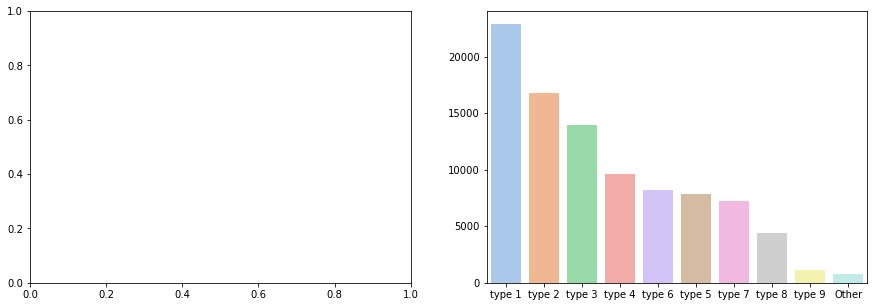

In [133]:
import matplotlib.pyplot as plt
import seaborn as sns
types_counts = result.Topic.value_counts()
fig, ax = plt.subplots(1, 2, figsize=(15,5))
types = sns.barplot(x = types_counts.index, y = types_counts.values, palette="pastel", ax=ax[1])


In [134]:
result['len'] = result.Text.apply(lambda row: len(row.split()))
result.head()

,Text,Topic,Lemma-text,len
0,"this child almost died tetanus, spent months h...",type 1,"[child, almost, died, tetanus, spent, month, h...",21
1,just remember mr. leblanc the pressure that th...,type 8,"[remember, leblanc, pressure, provincial, busi...",48
2,does it hurt your head actually use your brain...,type 5,"[hurt, head, actually, use, brain, seem, incre...",37
3,world-wide mass vaccination leading world-wide...,type 8,"[world, wide, mass, leading, world, wide, digi...",11
4,oh i see. so what your saying is that alberta ...,type 8,"[see, saying, alberta, business, required, ask...",26


In [135]:
result['Lemma_text'] = result['Lemma-text'].apply(lambda row: ' '.join(row))

In [136]:
result = result.drop('Lemma-text', axis=1)

In [137]:
from wordcloud import WordCloud 

In [138]:
def create_WordCloud(data, title=None):
    wordcloud = WordCloud(width = 500, height = 500,
                          background_color ='white',
                          min_font_size = 15, collocations=False
                         ).generate(" ".join(data.values))
                      
    plt.figure(figsize = (5, 5), facecolor = None) 
    plt.imshow(wordcloud, interpolation='bilinear') 
    plt.axis("off") 
    plt.tight_layout(pad = 0) 
    plt.title(title,fontsize=20)
    plt.show() 

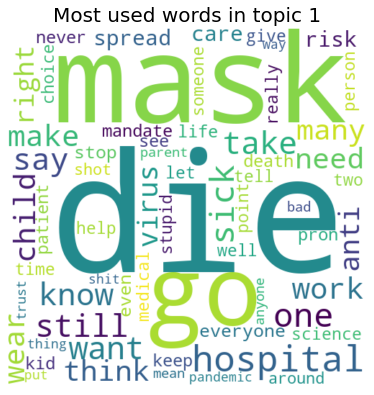

In [139]:
create_WordCloud(result['Lemma_text'].loc[result.Topic == 'type 1'], title="Most used words in topic 1")

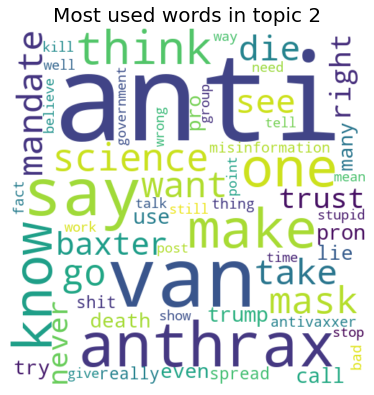

In [140]:
create_WordCloud(result['Lemma_text'].loc[result.Topic == 'type 2'], title="Most used words in topic 2")

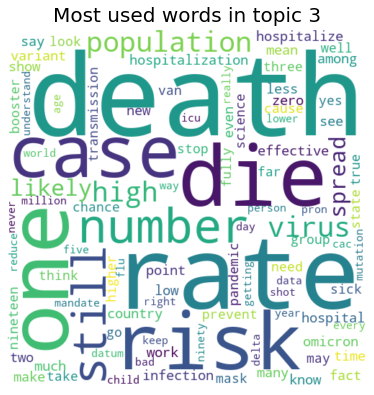

In [141]:
create_WordCloud(result['Lemma_text'].loc[result.Topic == 'type 3'], title="Most used words in topic 3")

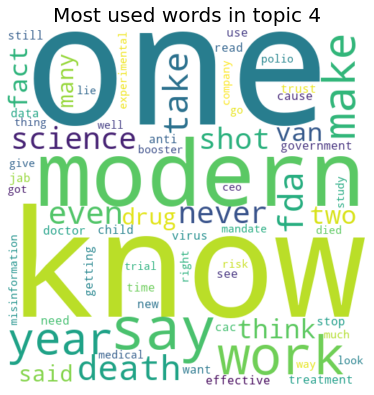

In [142]:
create_WordCloud(result['Lemma_text'].loc[result.Topic == 'type 4'], title="Most used words in topic 4")

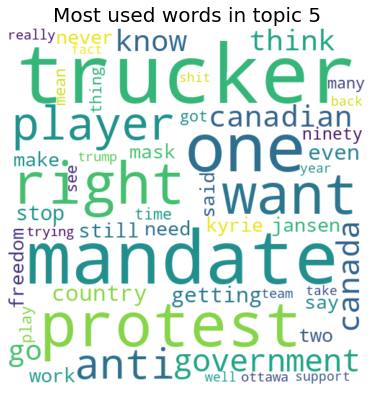

In [143]:
create_WordCloud(result['Lemma_text'].loc[result.Topic == 'type 5'], title="Most used words in topic 5")

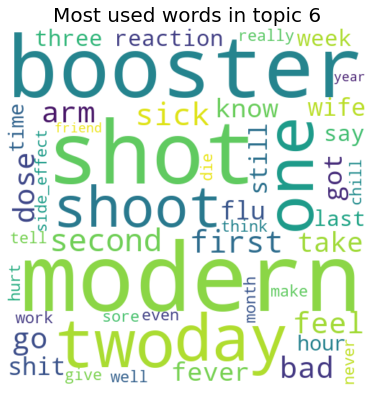

In [144]:
create_WordCloud(result['Lemma_text'].loc[result.Topic == 'type 6'], title="Most used words in topic 6")

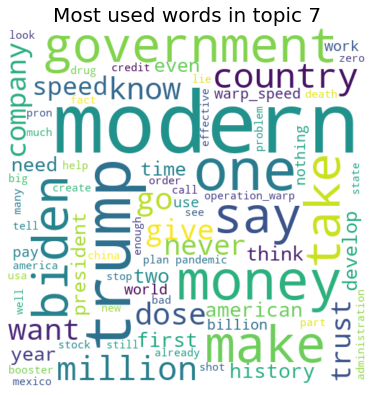

In [145]:
create_WordCloud(result['Lemma_text'].loc[result.Topic == 'type 7'], title="Most used words in topic 7")

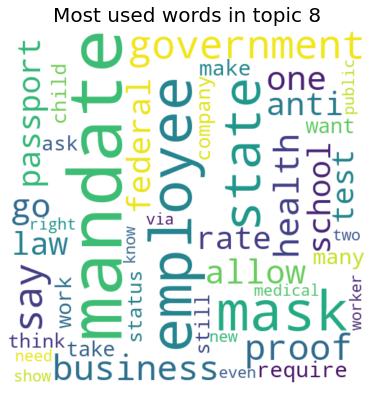

In [146]:
create_WordCloud(result['Lemma_text'].loc[result.Topic == 'type 8'], title="Most used words in topic 8")

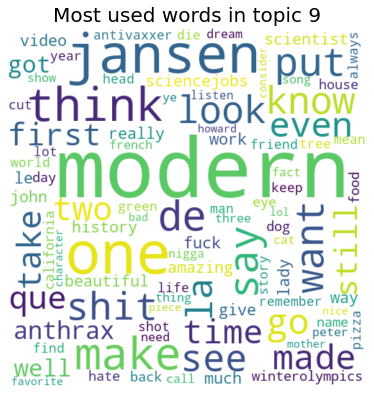

In [147]:
create_WordCloud(result['Lemma_text'].loc[result.Topic == 'type 9'], title="Most used words in topic 9")

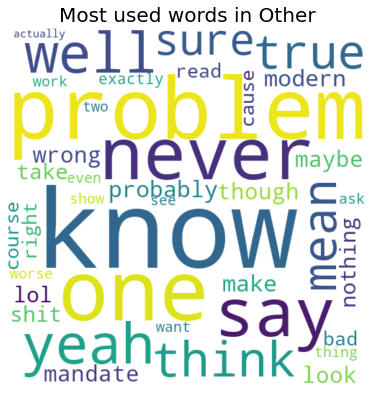

In [148]:
create_WordCloud(result['Lemma_text'].loc[result.Topic == 'Other'], title="Most used words in Other")

### Cluster size: 10

In [149]:
mgp = MovieGroupProcess(K=10, alpha=0.1, beta=0.2, n_iters=30)

vocab = set(x for review in negative_tokenised_lemmatized for x in review)
n_terms = len(vocab)
model = mgp.fit(negative_tokenised_lemmatized, n_terms)

In stage 0: transferred 78698 clusters with 10 clusters populated
In stage 1: transferred 63394 clusters with 10 clusters populated
In stage 2: transferred 45479 clusters with 10 clusters populated
In stage 3: transferred 33572 clusters with 10 clusters populated
In stage 4: transferred 28100 clusters with 10 clusters populated
In stage 5: transferred 25788 clusters with 10 clusters populated
In stage 6: transferred 24308 clusters with 10 clusters populated
In stage 7: transferred 23265 clusters with 10 clusters populated
In stage 8: transferred 22728 clusters with 10 clusters populated
In stage 9: transferred 22276 clusters with 10 clusters populated
In stage 10: transferred 21830 clusters with 10 clusters populated
In stage 11: transferred 21641 clusters with 10 clusters populated
In stage 12: transferred 21405 clusters with 10 clusters populated
In stage 13: transferred 21300 clusters with 10 clusters populated
In stage 14: transferred 21133 clusters with 10 clusters populated
In st

In [150]:
doc_count = np.array(mgp.cluster_doc_count)
print('Number of documents per topic :', doc_count)

# topics sorted by the number of document they are allocated to
top_index = doc_count.argsort()[-10:][::-1]
print('\nMost important clusters (by number of docs inside):', top_index)
# show the top 5 words in term frequency for each cluster 
top_words(mgp.cluster_word_distribution, top_index, 10)

Number of documents per topic : [ 1330 15484 17655  7044  7720 10514  4347 12958  7981  7790]

Most important clusters (by number of docs inside): [2 1 7 5 8 9 4 3 6 0]

Cluster 2 : [('get', 6504), ('not', 5481), ('die', 2564), ('go', 2520), ('hospital', 2508), ('mask', 2271), ('one', 1724), ('anti', 1631), ('take', 1593), ('want', 1581)]

Cluster 1 : [('anti', 8362), ('not', 3924), ('van', 3184), ('get', 2478), ('say', 1773), ('anthrax', 1611), ('like', 1380), ('know', 1239), ('think', 1194), ('one', 1193)]

Cluster 7 : [('not', 3973), ('get', 3366), ('one', 1408), ('know', 1191), ('getting', 1078), ('like', 1009), ('would', 1000), ('mask', 979), ('still', 825), ('want', 807)]

Cluster 5 : [('not', 3921), ('get', 3510), ('virus', 1955), ('die', 1801), ('spread', 1608), ('still', 1292), ('risk', 1284), ('death', 1251), ('one', 1126), ('effective', 985)]

Cluster 8 : [('not', 2051), ('modern', 1970), ('get', 1192), ('trump', 1035), ('one', 859), ('money', 841), ('say', 760), ('governmen

In [151]:
# I don`t rename the clusters

topic_dict = {}
topic_names = ['type 1',
               'type 2',
               'type 3',
               'type 4',
               'type 5',
               'type 6',
               'type 7',
               'type 8',
               'type 9',
               'type 10'
              ]
for i, topic_num in enumerate(top_index):
    topic_dict[topic_num]=topic_names[i] 

In [152]:
def create_topics_dataframe(data_text=negative_df.new_text_after_translation,  mgp=mgp, threshold=0.3, topic_dict=topic_dict, lemma_text=negative_tokenised_lemmatized):
    result = pd.DataFrame(columns=['Text', 'Topic', 'Lemma-text'])
    for i, text in enumerate(data_text):
        result.at[i, 'Text'] = text
        result.at[i, 'Lemma-text'] = lemma_text[i]
        prob = mgp.choose_best_label(negative_tokenised_lemmatized[i])
        if prob[1] >= threshold:
            result.at[i, 'Topic'] = topic_dict[prob[0]]
        else:
            result.at[i, 'Topic'] = 'Other'
    return result

In [153]:
result = create_topics_dataframe(data_text=negative_df.new_text_after_translation, mgp=mgp, threshold=0.3, topic_dict=topic_dict, lemma_text=negative_tokenised_lemmatized)
result.head(5)

,Text,Topic,Lemma-text
0,"this child almost died tetanus, spent months h...",type 6,"[child, almost, died, tetanus, spent, month, h..."
1,just remember mr. leblanc the pressure that th...,type 8,"[remember, leblanc, pressure, provincial, busi..."
2,does it hurt your head actually use your brain...,type 8,"[hurt, head, actually, use, brain, seem, incre..."
3,world-wide mass vaccination leading world-wide...,type 8,"[world, wide, mass, leading, world, wide, digi..."
4,oh i see. so what your saying is that alberta ...,type 8,"[see, saying, alberta, business, required, ask..."


In [154]:
import plotly.express as px

fig = px.pie(result, names='Topic',  title='Topics', color_discrete_sequence=px.colors.sequential.Burg)
fig.show()

In [155]:
result['Topic']

0        type 6
1        type 8
2        type 8
3        type 8
4        type 8
          ...  
92818    type 7
92819    type 7
92820    type 6
92821    type 6
92822    type 3
Name: Topic, Length: 92823, dtype: object

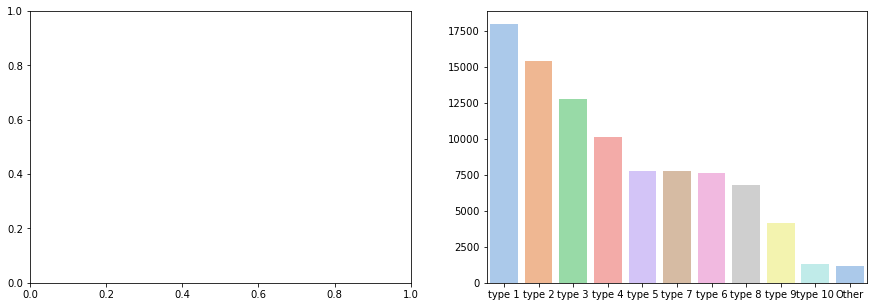

In [156]:
import matplotlib.pyplot as plt
import seaborn as sns
types_counts = result.Topic.value_counts()
fig, ax = plt.subplots(1, 2, figsize=(15,5))
types = sns.barplot(x = types_counts.index, y = types_counts.values, palette="pastel", ax=ax[1])


In [157]:
result['len'] = result.Text.apply(lambda row: len(row.split()))
result.head()

,Text,Topic,Lemma-text,len
0,"this child almost died tetanus, spent months h...",type 6,"[child, almost, died, tetanus, spent, month, h...",21
1,just remember mr. leblanc the pressure that th...,type 8,"[remember, leblanc, pressure, provincial, busi...",48
2,does it hurt your head actually use your brain...,type 8,"[hurt, head, actually, use, brain, seem, incre...",37
3,world-wide mass vaccination leading world-wide...,type 8,"[world, wide, mass, leading, world, wide, digi...",11
4,oh i see. so what your saying is that alberta ...,type 8,"[see, saying, alberta, business, required, ask...",26


In [158]:
result['Lemma_text'] = result['Lemma-text'].apply(lambda row: ' '.join(row))

In [159]:
result = result.drop('Lemma-text', axis=1)

In [160]:
from wordcloud import WordCloud 

In [161]:
def create_WordCloud(data, title=None):
    wordcloud = WordCloud(width = 500, height = 500,
                          background_color ='white',
                          min_font_size = 15, collocations=False
                         ).generate(" ".join(data.values))
                      
    plt.figure(figsize = (5, 5), facecolor = None) 
    plt.imshow(wordcloud, interpolation='bilinear') 
    plt.axis("off") 
    plt.tight_layout(pad = 0) 
    plt.title(title,fontsize=20)
    plt.show() 

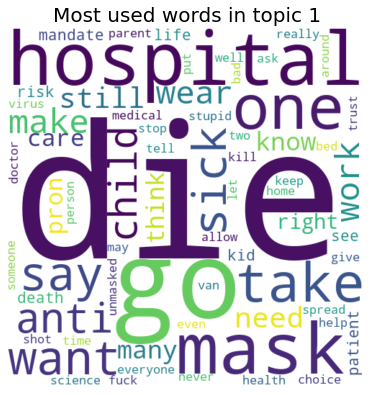

In [162]:
create_WordCloud(result['Lemma_text'].loc[result.Topic == 'type 1'], title="Most used words in topic 1")

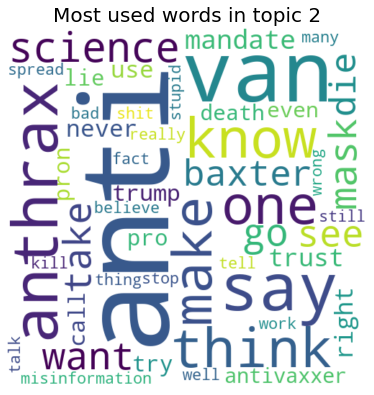

In [163]:
create_WordCloud(result['Lemma_text'].loc[result.Topic == 'type 2'], title="Most used words in topic 2")

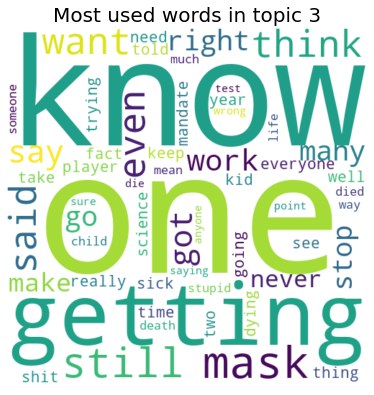

In [164]:
create_WordCloud(result['Lemma_text'].loc[result.Topic == 'type 3'], title="Most used words in topic 3")

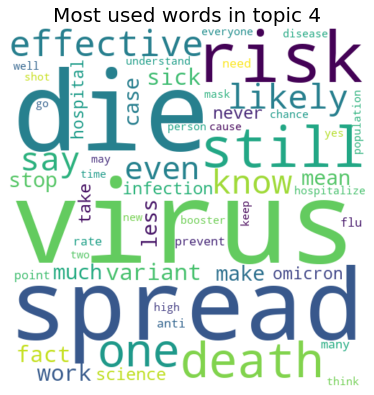

In [165]:
create_WordCloud(result['Lemma_text'].loc[result.Topic == 'type 4'], title="Most used words in topic 4")

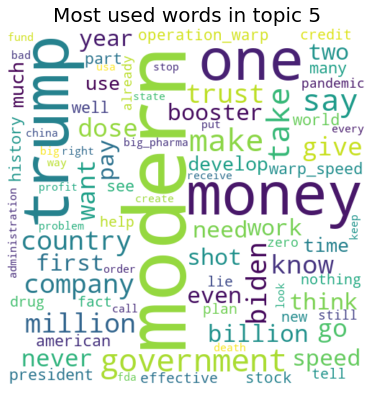

In [166]:
create_WordCloud(result['Lemma_text'].loc[result.Topic == 'type 5'], title="Most used words in topic 5")

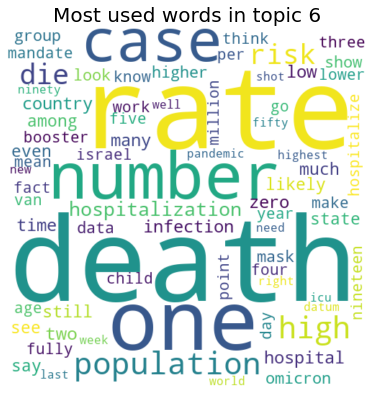

In [167]:
create_WordCloud(result['Lemma_text'].loc[result.Topic == 'type 6'], title="Most used words in topic 6")

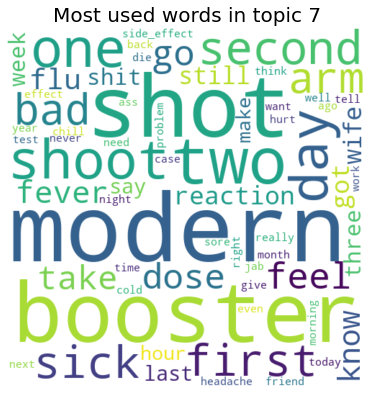

In [168]:
create_WordCloud(result['Lemma_text'].loc[result.Topic == 'type 7'], title="Most used words in topic 7")

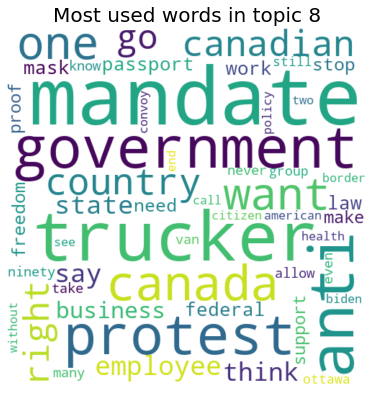

In [169]:
create_WordCloud(result['Lemma_text'].loc[result.Topic == 'type 8'], title="Most used words in topic 8")

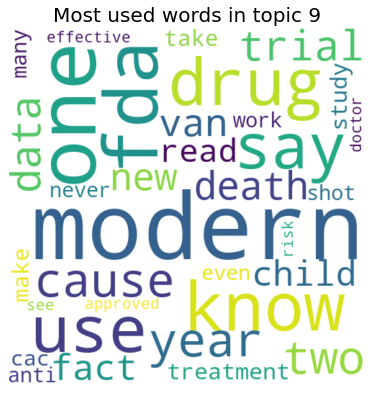

In [170]:
create_WordCloud(result['Lemma_text'].loc[result.Topic == 'type 9'], title="Most used words in topic 9")

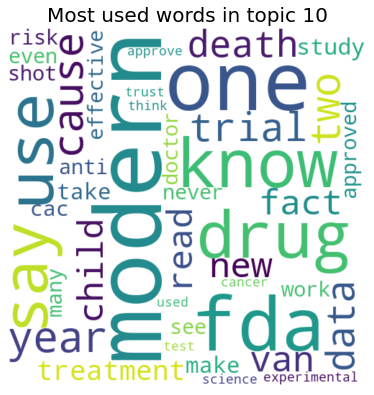

In [171]:
create_WordCloud(result['Lemma_text'].loc[result.Topic == 'type 9'], title="Most used words in topic 10")

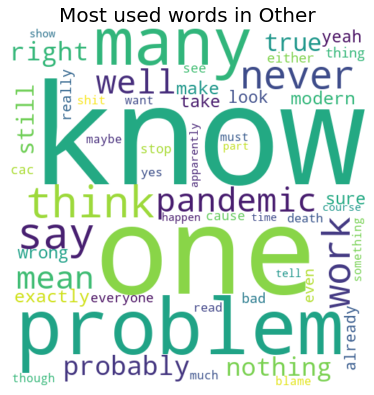

In [172]:
create_WordCloud(result['Lemma_text'].loc[result.Topic == 'Other'], title="Most used words in Other")